<a href="https://colab.research.google.com/github/Nagore2021/Phyton/blob/main/Trabajo_deep_learning_nagore.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **TRABAJO DE DEEP LEARNING (I) Y (II)**

# Manejo de Datasets Desbalanceados


**Introducción al Proyecto: Avances en la Clasificación de Datasets Desbalanceados**

---

**Contexto del Desafío**
- **Objetivo:** Trabajar datasets desbalanceados usando CIFAR-10, modificado para reducir la representación de la clase "truck".

**Estrategias de Modelado y Optimización**
- **Enfoque:** Implementar y optimizar modelos de redes neuronales convolucionales

**Fase 1: `SimpleCNN`**
- **Acción:** Establecer una línea base de rendimiento con un modelo convolucional simple entrenado en el dataset desbalanceado.

**Fase 2: Optimización de `SimpleCNN`**
- **Mejora:** Aplicar `ReduceLROnPlateau` para ajustar la tasa de aprendizaje basándose en el rendimiento de la validación, buscando optimizar el entrenamiento.

**Fase 3: `ImprovedCNN`**
- **Desarrollo:** Mejorar la arquitectura introduciendo Dropout y Batch Normalization en `SimpleCNN` para aumentar la generalización y prevenir el sobreajuste.

**Fase 4: Balanceo con IA Generativa**
- **Innovación:** Utilizar técnicas de IA generativa para crear un balance más equitativo en el dataset, añadiendo imágenes sintéticas para las clases menos representadas.

**Evaluación Comparativa y Decisiones Futuras**

- **Acción Siguiente:** Volver a entrenar y ajustar el modelo con nuevas estrategias o datos ampliados para mejorar los resultados.




In [44]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Subset
from torch.utils.data import Dataset
import torchvision
from torchvision import datasets, transforms
from torchvision.datasets import CIFAR10
from torchvision.utils import make_grid
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
from sklearn.metrics import recall_score, f1_score, accuracy_score

from tqdm.auto import tqdm
from PIL import Image


import time
import numpy as np
import pandas as pd
import seaborn as sn  # for heatmaps
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve
import matplotlib.pyplot as plt
%matplotlib inline

In [45]:
device = (
    "cuda" if torch.cuda.is_available() else
    "mps" if torch.backends.mps.is_available() else
    "cpu"
)
print(f"Usando dispositivo: {device}")

Usando dispositivo: cpu


In [46]:
torch.cuda.is_available()

False

In [47]:
#establecer una semilla para reproducir el experimento
torch.manual_seed(101)
np.random.seed(101)

In [98]:
def CalcularCurvaRoc(y_val_true, y_val_pred):
  # Calcular la curva ROC

  # Calcular el área bajo la curva ROC
  auc_score = roc_auc_score(y_val_true, y_val_pred)

  print("Área bajo la curva ROC (AUC):", auc_score)
  fpr, tpr, thresholds = roc_curve(y_val_true, y_val_pred)



  # Definir un umbral específico
  umbral = 0.5

  # Encontrar el índice del umbral más cercano en la lista de umbrales
  indice_umbral = min(range(len(thresholds)), key=lambda i: abs(thresholds[i]-umbral))

  # Graficar la curva ROC con el umbral específico
  plt.figure(figsize=(8, 6))
  plt.plot(fpr, tpr, label='Curva ROC')
  plt.scatter(fpr[indice_umbral], tpr[indice_umbral], c='red', label=f'Umbral {umbral} (AUC={auc_score:.2f})')
  plt.ylabel('Sensitivity')
  plt.xlabel('1 - Specificity')
  plt.axline((0, 0), (1, 1), linewidth=1, color='r')
  plt.title('Curva ROC con umbral específico')
  plt.legend(loc=4)
  plt.grid(True)
  plt.show()

In [48]:
###CODIGO PROPORCIONADO POR ANTONIO MARTINEZ
# callback early stopping para terminar el entrenamiento cuando la metrica en el conjunto de validacion se estanca, empeora o no mejora lo suficiente conforme aumentan las epocas
class earlyStopping:
    def __init__(self, patience=3, min_delta=0.0, mode="min"):
        """
        Args:
            patience (int): El entrenamiento para si en 'patience' numero de epocas la metrica de monitorizacion no ha mejorado
            min_delta (float): Cambio minimo en valor absoluto en la metrica de monitorizacion para considerar el resultado como una mejora respecto de la epoca anterior
            mode (str): Uno de los valores 'max' o 'min'. Determina si el objetivo es minimizar o maximizar la metrica de monitorizacion
        """
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0 # inicializar el contador de epocas en la que la metrica no mejora
        self.stop = False # boolean flag para que determina cuando ha de parar el entrenamiento
        self.mode = mode

        if self.mode not in {"min", "max"}:
            raise ValueError(f"The value passed to the parameter 'mode' must be either 'max' or 'min'. Received {self.mode}")

        if self.min_delta < 0.0:
            raise ValueError(f"The value passed to the parameter min_delta must be greater than or equal to zero. Received {self.min_delta}")

        if self.mode == "max":
            self.best_score = 0.0
        else:
            self.best_score = 1e10

    def __call__(self, new_score):

        if self.mode == "max":
            metric_improved = (new_score - self.best_score > self.min_delta)
        elif self.mode == "min":
            metric_improved = (self.best_score - new_score > self.min_delta)

        if metric_improved:
            self.best_score = new_score
            self.counter = 0
        else:
            # si la metrica no ha mejorado añadimos una unidad al contador de epocas sin mejora
            self.counter += 1
            # comprobamos si hay que parar el entrenamiento
            if self.counter == self.patience:
                self.stop = True


# callback model checkpoint para guardar el mejor modelo obtenido hasta la fecha (pesos del modelo y estado del optimizador)
class modelCheckpoint:
    def __init__(self, path, min_delta=0.0, mode="min"):
        """
        Args:
            path (str): ruta donde almacenar los pesos del modelo y el estado del optimizador
        """
        if not path:
            path = "unerCarvana.pth"
        self.path = path
        self.mode = mode
        self.min_delta = min_delta

        if self.mode not in {"min", "max"}:
            raise ValueError(f"The value passed to the parameter 'mode' must be either 'max' or 'min'. Received {self.mode}")

        if self.min_delta < 0.0:
            raise ValueError(f"The value passed to the parameter min_delta must be greater than or equal to zero. Received {self.min_delta}")

        if self.mode == "max":
            self.best_score = 0.0
        else:
            self.best_score = 1e10

    def __call__(self, model, optimizer, new_score):

        if self.mode == "max":
            metric_improved = (new_score - self.best_score > self.min_delta)
        elif self.mode == "min":
            metric_improved = (self.best_score - new_score > self.min_delta)

        if metric_improved:
            torch.save({
                'model_state_dict' : model.state_dict(),
                'optimizer_state_dict' : optimizer.state_dict(),
                }, self.path)
            self.best_score = new_score

# **Carga y Preprocesamiento de Datos:**
Carga de CIFAR-10 y definición de transformaciones.

In [49]:
from torchvision import transforms

# Transformaciones para el conjunto de entrenamiento
train_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),  # Aplica volteo horizontal aleatoriamente
    transforms.RandomRotation(20),  # Rota las imágenes hasta 20 grados aleatoriamente
    transforms.RandomCrop(32, padding=1),  # Aplica recortes aleatorios con relleno
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),  # Ajusta brillo, contraste y saturación de manera aleatoria
    transforms.ColorJitter(brightness=(0.5,1.5), contrast=(1), saturation=(0.5,1.5), hue=(-0.1,0.1)),
    transforms.ToTensor(),  # Convierte a tensor
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),  # Normalización
])

# Transformaciones para el conjunto de prueba
test_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
])


In [50]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [51]:
# Cargar el dataset CIFAR-10 sin aplicar ninguna transformación específica
cifar10_dataset = datasets.CIFAR10(root='/content/drive/MyDrive/Colab Notebooks/MASTER IA/Trabajo_Deep_Learning/Data', train=True, download=True)


Files already downloaded and verified


In [52]:
# Definición de la clase CIFAR10Subset
class CIFAR10Subset(Dataset):
    def __init__(self, cifar10_dataset, class_indices, class_names, transform=None):
        self.data = []
        self.targets = []
        self.classes = class_names
        self.transform = transform
        index_map = {class_indices[0]: 0, class_indices[1]: 1}

        for i, (img, label) in enumerate(cifar10_dataset):
            if label in class_indices:
                self.data.append(img)
                self.targets.append(index_map[label])

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):

        img, label = self.data[idx], self.targets[idx]
        if isinstance(img, Image.Image):  # Solo aplicar si img es una imagen PIL
            if self.transform:
                img = self.transform(img)
        return img, label

In [53]:
class_indices = [1, 9]  #  'automobile' (1) y 'truck' (9)
class_names = ['automobile', 'truck']

subset = CIFAR10Subset(cifar10_dataset, class_indices, class_names)


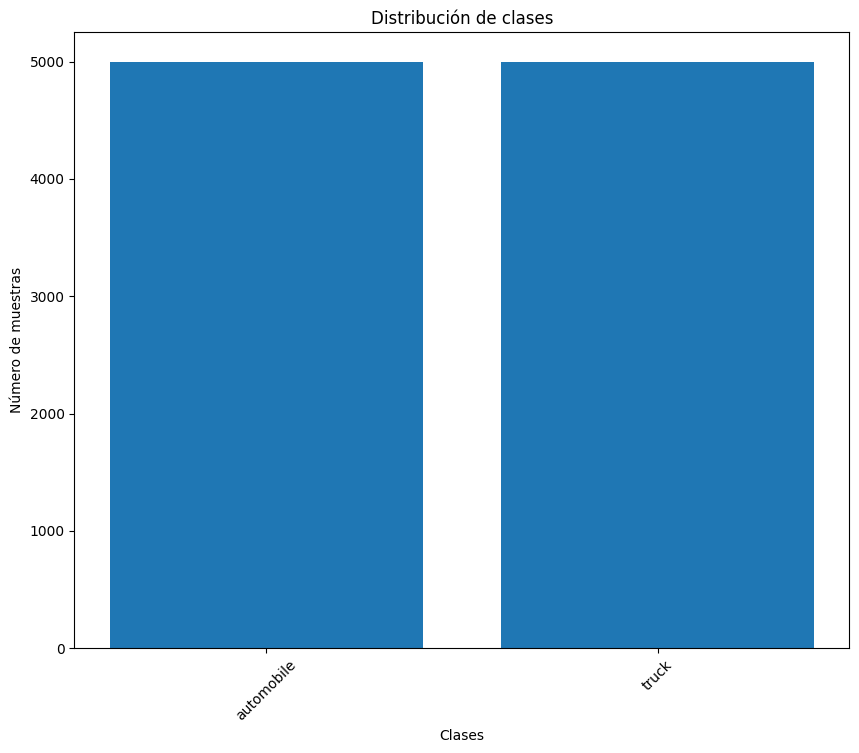

In [54]:
def plot_class_distribution(dataset, class_names, title):
    class_counts = [0] * len(class_names)

    # Contar el número de muestras por clase
    for _, label in dataset:
        class_counts[label] += 1

    # Graficar la distribución de clases
    plt.figure(figsize=(10, 8))
    plt.bar(class_names, class_counts)
    plt.xlabel('Clases')
    plt.ylabel('Número de muestras')
    plt.title(title)
    plt.xticks(rotation=45)
    plt.show()

# Visualizar la distribución de clases en el conjunto de entrenamiento desbalanceado
plot_class_distribution(subset, ['automobile', 'truck'], 'Distribución de clases')

In [55]:
#carga de los datos

#trasformaciones para el conjunto de entreanmiento
full_train_data = datasets.CIFAR10(root='/content/drive/MyDrive/Colab Notebooks/MASTER IA/Trabajo_Deep_Learning/Data', train=True, download=True)

full_test_data = datasets.CIFAR10(root='/content/drive/MyDrive/Colab Notebooks/MASTER IA/Trabajo_Deep_Learning/Data', train=False, download=True)

Files already downloaded and verified
Files already downloaded and verified


In [56]:
full_train_data

Dataset CIFAR10
    Number of datapoints: 50000
    Root location: /content/drive/MyDrive/Colab Notebooks/MASTER IA/Trabajo_Deep_Learning/Data
    Split: Train

In [57]:
full_test_data

Dataset CIFAR10
    Number of datapoints: 10000
    Root location: /content/drive/MyDrive/Colab Notebooks/MASTER IA/Trabajo_Deep_Learning/Data
    Split: Test

In [58]:
# Crear los subconjuntos de entrenamiento y prueba con transformaciones
subset_train = CIFAR10Subset(full_train_data, class_indices, class_names, train_transforms)
subset_test = CIFAR10Subset(full_test_data, class_indices, class_names, test_transforms)

In [59]:
# Creación de DataLoaders

full_train_loader = DataLoader(subset_train, batch_size=64, shuffle=True)
full_test_loader = DataLoader(subset_test, batch_size=64, shuffle=False)


Label: [0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 0 1
 1 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 0 0 1]


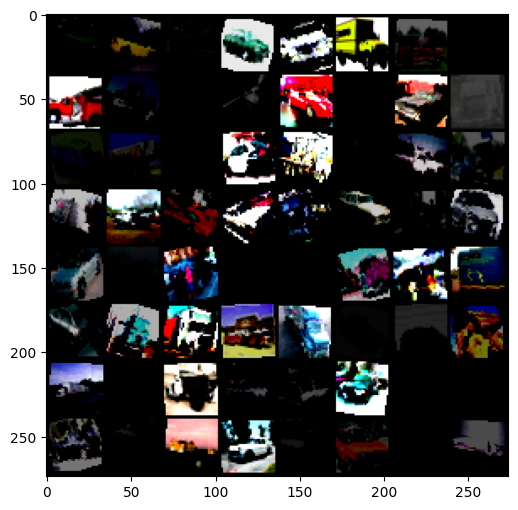

In [60]:
#visualizar las imágenes
#extraer solo un batch de imágenes
for images,labels in full_train_loader:
    break


print('Label:', labels.numpy())

im = make_grid(images, nrow=8)
plt.figure(figsize=(10,6))
plt.imshow(np.transpose(im.numpy(), (1, 2, 0)));   # (de CHW a HWC)

# **Crear un Dataset Desbalanceado**

Clase a desbalancear : Clase truck
Reducir el número de muestras en la clase "truck" para crear un desbalanceo.

La clase "truck" está etiquetada como 9 en CIFAR-10:

In [61]:
# Filtrar para obtener solo las imágenes de la clase 'truck'
truck_indices = [i for i, label in enumerate(subset_train.targets) if label == 1]
truck_data = [subset_train[i] for i in truck_indices]


In [62]:
# Seleccionar un subconjunto de imágenes de camiones para visualizar
truck_images_to_show = torch.stack([data[0] for data in truck_data[:5]])  # Las primeras 5 imágenes de truck

In [63]:
# Utilizo make_grid para organizar las imágenes en una cuadrícula
grid = torchvision.utils.make_grid(truck_images_to_show)

In [64]:
def imshow(img):
    img = img / 2 + 0.5     # desnormalizar, en un rango de valores de 0,1
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

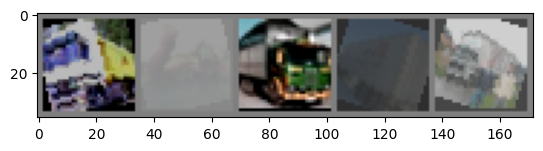

In [65]:
# Mostrar las imágenes
imshow(torchvision.utils.make_grid(truck_images_to_show))

In [66]:
import numpy as np

def desbalancear_dataset1(dataset, clase_objetivo=1, proporcion=0.1):
    targets = np.array(dataset.targets)

    # Obtiene los índices de las muestras de la clase objetivo
    indices_clase_objetivo = np.where(targets == clase_objetivo)[0]

    # Mezcla aleatoriamente y reduce según la proporción especificada
    np.random.shuffle(indices_clase_objetivo)
    reduced_indices_clase_objetivo = indices_clase_objetivo[:int(len(indices_clase_objetivo) * proporcion)]

    print(f"Número original de muestras de 'truck': {len(indices_clase_objetivo)}")
    print(f"Número reducido de muestras de 'truck': {len(reduced_indices_clase_objetivo)}")

    # Crea un nuevo Subset excluyendo las muestras de la clase objetivo reducidas
    indices_finales = np.setdiff1d(np.arange(len(targets)), reduced_indices_clase_objetivo)

    print(f"Total de muestras en el dataset desbalanceado: {len(indices_finales)}")

    # Crea un nuevo Subset
    dataset_desbalanceado = Subset(dataset, indices_finales)

    return dataset_desbalanceado


In [67]:
def desbalancear_dataset(dataset, clase_objetivo=1, proporcion=0.1):
    targets = np.array(dataset.targets)

    # Obtiene los índices de las muestras de la clase objetivo
    indices_clase_objetivo = np.where(targets == clase_objetivo)[0]

    # Mezcla aleatoriamente y reduce según la proporción especificada
    np.random.shuffle(indices_clase_objetivo)
    reduced_indices_clase_objetivo = indices_clase_objetivo[:int(len(indices_clase_objetivo) * proporcion)]

    print(f"Número original de muestras de 'truck': {len(indices_clase_objetivo)}")
    print(f"Número reducido de muestras de 'truck': {len(reduced_indices_clase_objetivo)}")

    # Obtener índices de todas las otras clases
    indices_no_objetivo = np.where(targets != clase_objetivo)[0]

    # Combinar y crear un nuevo Subset
    indices_finales = np.concatenate((reduced_indices_clase_objetivo, indices_no_objetivo))

    print(f"Total de muestras en el dataset desbalanceado: {len(indices_finales)}")

    # Crea un nuevo Subset
    dataset_desbalanceado = Subset(dataset, indices_finales)


    return dataset_desbalanceado


In [68]:
clase_objetivo=1   #clase truck
proporcion=0.4

train_dataset_desbalanceado = desbalancear_dataset(subset_train, clase_objetivo=clase_objetivo, proporcion=proporcion)
train_loader_desbalanceado = DataLoader(train_dataset_desbalanceado, batch_size=64, shuffle=True)

test_dataset_desbalanceado = desbalancear_dataset(subset_test, clase_objetivo=clase_objetivo, proporcion=proporcion)
test_loader_desbalanceado = DataLoader(test_dataset_desbalanceado, batch_size=64, shuffle=False)



Número original de muestras de 'truck': 5000
Número reducido de muestras de 'truck': 2000
Total de muestras en el dataset desbalanceado: 7000
Número original de muestras de 'truck': 1000
Número reducido de muestras de 'truck': 400
Total de muestras en el dataset desbalanceado: 1400


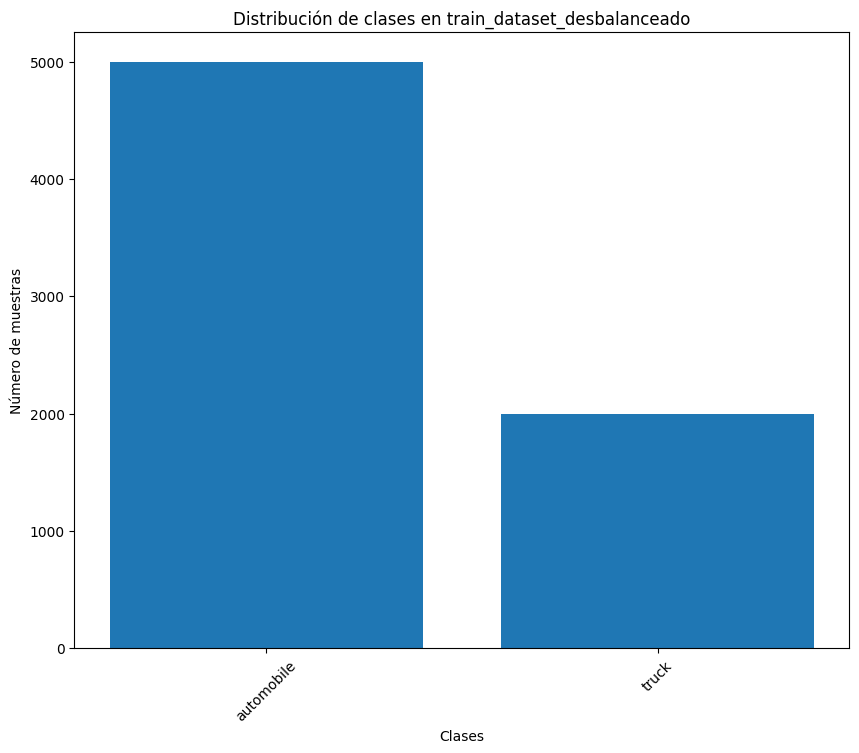

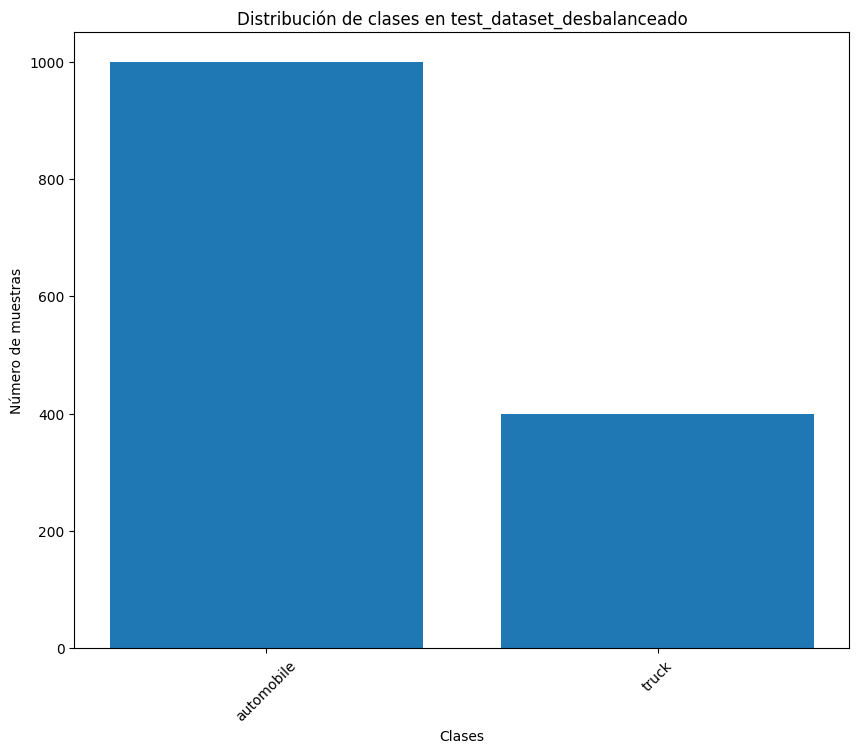

In [69]:
class_names=['automobile', 'truck']
# Visualizar la distribución de clases en el conjunto de entrenamiento desbalanceado
plot_class_distribution(train_dataset_desbalanceado, class_names, 'Distribución de clases en train_dataset_desbalanceado')

# Visualizar la distribución de clases en el conjunto de prueba desbalanceado
plot_class_distribution(test_dataset_desbalanceado, class_names, 'Distribución de clases en test_dataset_desbalanceado')


# **Entrenar el modelo**

## **Modelo Simple**

SimpleCNN
Empiezo con un modelo sencillo y a partir de ahí,

La fórmula para calcular el tamaño de cada dimensión de la salida después de la convolución es ((W - F + 2P) / S) + 1, donde W es el tamaño de la entrada, F es el tamaño del kernel, P es el padding, y S es el stride.

Dimensiones de la salida en cada capa :

**Salida conv1:** ((32 - 3 + 2*1) / 1) + 1 = 32.

W = 32
F = 3*3
S= 1
P=1
El tamaño de cada dimensión espacial (ancho y alto) = 32
Canales= 32debido a los 32 filtros aplicados.
La salida de esta capa es entonces 32x32x32.

**Capa de Max Pooling:**

F = 2*2
S= 2

Esto reduce cada dimensión espacial a la mitad: 32 / 2 = 16.
La salida después de esta capa de pooling es 16x16x32.

**Salida conv2**
La entrada ahora es 16x16x32.
W = 16
F = 3
P = 1
S = 1

Aplicando la fórmula: ((16 - 3 + 2*1) / 1) + 1 = 16.

El tamaño sigue siendo 16x16,
Se aplican 64 filtros.
La salida de esta capa es entonces 16x16x64.

**Segunda Capa de Pooling**

Se reduce cada dimensión espacial a la mitad de nuevo: 16 / 2 = 8.
La salida después de esta capa es 8x8x64.


Antes de pasar a la primera capa totalmente conectada fc1, **aplanamos la salida de la última capa de pooling, que es de 8x8x64**.

x = x.view(-1, 64 * 8 * 8) Esto da como resultado un vector de tamaño 8*8*64 = 4096


In [70]:
class SimpleCNN(nn.Module):
    def __init__(self):
        super(SimpleCNN, self).__init__()

        # Capa convolucional 1
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, padding=1)
        self.act1 = nn.ReLU()
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Capa convolucional 2
        self.conv2 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
        self.act2 = nn.ReLU()
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Capa convolucional 3
        self.conv3 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.act3 = nn.ReLU()
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Capa totalmente conectada
        self.fc1 = nn.Linear(64 * 4 * 4, 128)
        self.act4 = nn.ReLU()

        # Capa de salida
        self.fc2 = nn.Linear(128, 2)  # Salida para 2 clases

    def forward(self, x):
        x = self.pool1(self.act1(self.conv1(x)))
        x = self.pool2(self.act2(self.conv2(x)))
        x = self.pool3(self.act3(self.conv3(x)))
        x = x.view(-1, 64 * 4 * 4)  # Aplanar las características para la capa totalmente conectada
        x = self.act4(self.fc1(x))
        x = self.fc2(x)
        return x


In [71]:
model = SimpleCNN()
model.to(device)  # Mueve el modelo al dispositivo seleccionado
model

SimpleCNN(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (act1): ReLU()
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (act2): ReLU()
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (act3): ReLU()
  (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=1024, out_features=128, bias=True)
  (act4): ReLU()
  (fc2): Linear(in_features=128, out_features=2, bias=True)
)

In [72]:
optimizer = optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

In [73]:
def count_parameters(model):
    params = [p.numel() for p in model.parameters() if p.requires_grad]
    for item in params:
        print(f'{item:>6}')
    print(f'______\n{sum(params):>6}')

In [74]:
count_parameters(model)

   432
    16
  4608
    32
 18432
    64
131072
   128
   256
     2
______
155042


### **Entrenar el modelo Simple**

In [75]:
# Guardar el modelo simple
path_to_save_model = "./trabajo-deep-learning-modelosimple.pth"
early_stopping = earlyStopping(patience=5, min_delta=0.01, mode="max")
model_checkpoint = modelCheckpoint(path=path_to_save_model, min_delta=0.01, mode="max")


In [76]:
import time
train_losses = []
val_losses = []
train_f1_scores = []
val_f1_scores = []
epochs = 100
val_loader = test_loader_desbalanceado

start_time = time.time()
model.to(device)

for epoch in range(epochs):
    model.train()
    trn_loss_epoch = 0
    y_train_true = []
    y_train_pred = []

    for X_train, y_train in train_loader_desbalanceado:
        X_train, y_train = X_train.to(device), y_train.to(device)
        optimizer.zero_grad()
        y_pred = model(X_train)
        loss = criterion(y_pred, y_train)
        loss.backward()
        optimizer.step()

        trn_loss_epoch += loss.item()
        preds = torch.argmax(y_pred, dim=1).detach().cpu().numpy()
        y_train_true.extend(y_train.detach().cpu().numpy())
        y_train_pred.extend(preds)

    train_loss = trn_loss_epoch / len(train_loader_desbalanceado)
    train_f1 = f1_score(y_train_true, y_train_pred, average='macro')
    train_losses.append(train_loss)
    train_f1_scores.append(train_f1)

    model.eval()
    val_loss_epoch = 0
    y_val_true = []
    y_val_pred = []
    val_correct = 0
    total_val_samples =0  # el total de muestras de validación

    with torch.no_grad():
        for X_val, y_val in val_loader:
          X_val, y_val = X_val.to(device), y_val.to(device)
          outputs = model(X_val)
          loss = criterion(outputs, y_val)
          val_loss_epoch += loss.item()
          preds = torch.argmax(outputs, dim=1).cpu().numpy()  # Convierte a numpy array
          val_correct += (preds == y_val.cpu().numpy()).sum()
          total_val_samples += y_val.size(0)
          y_val_true.extend(y_val.cpu().numpy())  # Extender la lista con los valores de y_val
          y_val_pred.extend(preds)  # Extender la lista con los valores de preds

    val_loss = val_loss_epoch / len(val_loader)
    val_f1 = f1_score(y_val_true, y_val_pred, average='macro')
    val_losses.append(val_loss)
    val_f1_scores.append(val_f1)

    print(f'Epoch {epoch + 1}, Train Loss: {train_loss:.4f}, Train F1 Score: {train_f1:.4f}, '
          f'Val Loss: {val_loss:.4f}, Val F1 Score: {val_f1:.4f}')

    # Llamadas a los callbacks
    early_stopping(val_f1)
    # Guarda el modelo si mejora
    model_checkpoint(model, optimizer, val_f1)

    if early_stopping.stop:
        print("Deteniendo el entrenamiento por Early Stopping.")
        break

print(f'Duración: {time.time() - start_time:.0f} segundos')


Epoch 1, Train Loss: 0.5792, Train F1 Score: 0.4243, Val Loss: 0.5164, Val F1 Score: 0.4167
Epoch 2, Train Loss: 0.5350, Train F1 Score: 0.4167, Val Loss: 0.4826, Val F1 Score: 0.4167
Epoch 3, Train Loss: 0.5080, Train F1 Score: 0.5259, Val Loss: 0.4637, Val F1 Score: 0.7471
Epoch 4, Train Loss: 0.4788, Train F1 Score: 0.6826, Val Loss: 0.3901, Val F1 Score: 0.7959
Epoch 5, Train Loss: 0.4425, Train F1 Score: 0.7185, Val Loss: 0.4005, Val F1 Score: 0.7861
Epoch 6, Train Loss: 0.4201, Train F1 Score: 0.7404, Val Loss: 0.3361, Val F1 Score: 0.8302
Epoch 7, Train Loss: 0.3929, Train F1 Score: 0.7726, Val Loss: 0.3181, Val F1 Score: 0.8306
Epoch 8, Train Loss: 0.3684, Train F1 Score: 0.7898, Val Loss: 0.2949, Val F1 Score: 0.8552
Epoch 9, Train Loss: 0.3510, Train F1 Score: 0.8053, Val Loss: 0.2657, Val F1 Score: 0.8763
Epoch 10, Train Loss: 0.3368, Train F1 Score: 0.8176, Val Loss: 0.2723, Val F1 Score: 0.8661
Epoch 11, Train Loss: 0.3299, Train F1 Score: 0.8205, Val Loss: 0.2463, Val F1 

In [ ]:

# Calcular la matriz de confusión
conf_matrix = confusion_matrix(y_val_true, y_val_pred)

# Visualizar la matriz de confusión
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=test_dataset_desbalanceado.dataset.classes, yticklabels=test_dataset_desbalanceado.dataset.classes)
plt.xlabel('Predicciones')
plt.ylabel('Etiquetas Verdaderas')
plt.title('Matriz de Confusión en el conjunto de validación')
plt.show()

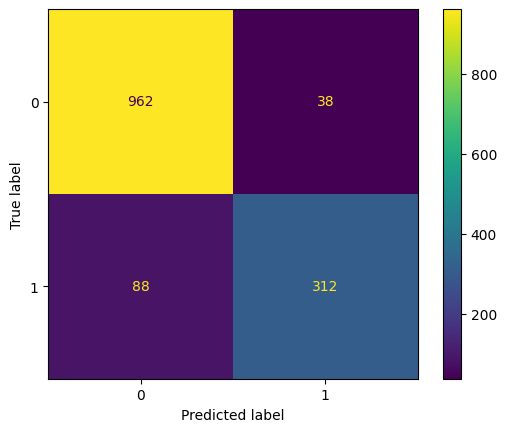

In [78]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
cm = confusion_matrix(y_val_true, y_val_pred)

cm_display = ConfusionMatrixDisplay(cm).plot()

In [ ]:
CalcularCurvaRoc(y_val_true, y_val_pred)

In [79]:
from sklearn.metrics import roc_auc_score

# Calcular el área bajo la curva ROC
auc_score = roc_auc_score(y_val_true, y_val_pred)

print("Área bajo la curva ROC (AUC):", auc_score)

Área bajo la curva ROC (AUC): 0.871


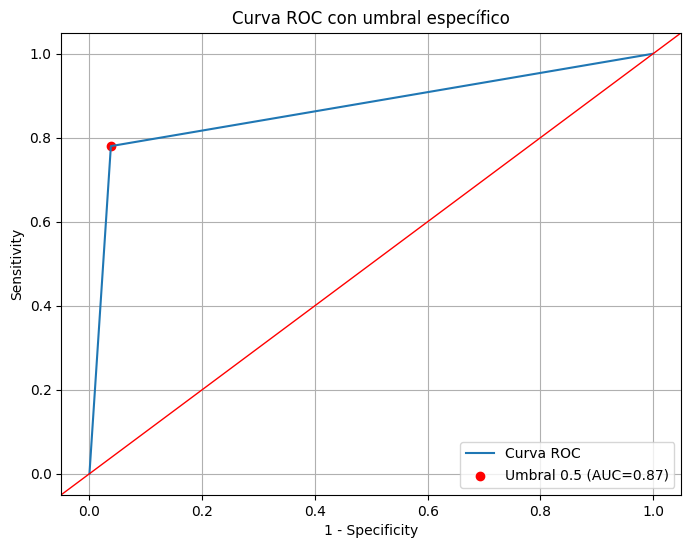

In [80]:
from sklearn.metrics import roc_curve
# Calcular la curva ROC
fpr, tpr, thresholds = roc_curve(y_val_true, y_val_pred)

# Definir un umbral específico
umbral = 0.5

# Encontrar el índice del umbral más cercano en la lista de umbrales
indice_umbral = min(range(len(thresholds)), key=lambda i: abs(thresholds[i]-umbral))

# Graficar la curva ROC con el umbral específico
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='Curva ROC')
plt.scatter(fpr[indice_umbral], tpr[indice_umbral], c='red', label=f'Umbral {umbral} (AUC={auc_score:.2f})')
plt.ylabel('Sensitivity')
plt.xlabel('1 - Specificity')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.title('Curva ROC con umbral específico')
plt.legend(loc=4)
plt.grid(True)
plt.show()


In [81]:
#torch.save(model.state_dict(), path_to_save_model)

###**Visualizar el modelo Simple**

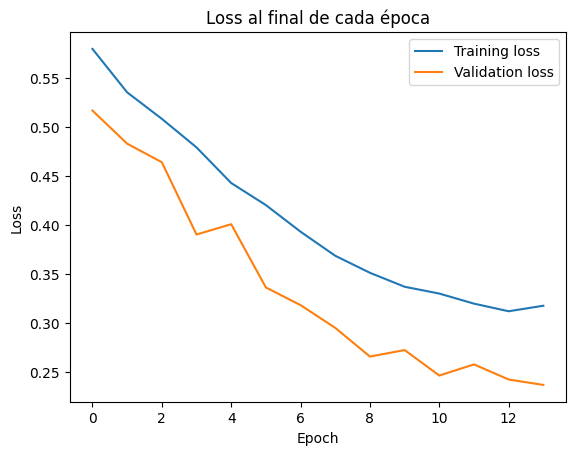

In [82]:
plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.title('Loss al final de cada época')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [83]:
# Instanciar el modelo
#model1 = SimpleCNN()

# Cargar el estado del modelo
#model1.load_state_dict(torch.load(path_to_save_model))


# Mover el modelo al dispositivo adecuado (e.g., GPU si está disponible)
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model1.to(device)


## **Mejorar el modelo**

In [84]:
class MejoradoCNN(nn.Module):
    def __init__(self):
        super(MejoradoCNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
        #Entrada: 32x32x3
        #Height = (H + 2 * padding - kernel) / stride + 1 = (32 + 2 * 1 - 3) / 1 + 1 = 32
        #W = (W + 2 * padding - kernel) / stride + 1 = (32 + 2 * 1 - 3) / 1 + 1 = 32

        #amaño de salida: 32x32x32

        self.bn1 = nn.BatchNorm2d(32)
        self.pool = nn.MaxPool2d(2, 2)
       # Tamaño de salida: 16x16x32

        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        # Tamaño de salida: 16x16x64


        self.bn2 = nn.BatchNorm2d(64)
        self.fc1 = nn.Linear(64 * 8 * 8, 128)  # Capa final reducida a 128 unidades
        self.dropout = nn.Dropout(0.5)  # Capa de Dropout antes de la capa final fc
        self.fc2 = nn.Linear(128, 2)  # Capa final con 2 unidades para las dos clases

    def forward(self, x):
        x = self.pool(F.relu(self.bn1(self.conv1(x))))
        x = self.pool(F.relu(self.bn2(self.conv2(x))))  # Aplicar BN después de ReLU
        x = x.view(-1, 64 * 8 * 8)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)  # Aplicar Dropout antes de la capa final
        x = self.fc2(x)
        return x


###**Entrenar el modelo con learning rate fijo**

In [85]:
ModeloMejor = MejoradoCNN()
ModeloMejor.to(device)  # Mueve el modelo al dispositivo seleccionado
ModeloMejor

MejoradoCNN(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=4096, out_features=128, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc2): Linear(in_features=128, out_features=2, bias=True)
)

In [86]:
def count_parameters(model):
    params = [p.numel() for p in model.parameters() if p.requires_grad]
    for item in params:
        print(f'{item:>6}')
    print(f'______\n{sum(params):>6}')

In [87]:
count_parameters(ModeloMejor)

   864
    32
    32
    32
 18432
    64
    64
    64
524288
   128
   256
     2
______
544258


In [88]:
# Definición del optimizador
optimizer = optim.Adam(ModeloMejor.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

In [89]:
# Guardar el mejor modelo
path_to_save_model = "./trabajo-deep-learning-ModeloMejor1.pth"
model_checkpoint = modelCheckpoint(path=path_to_save_model, min_delta=0.001, mode="max")
early_stopping = earlyStopping(patience=5, min_delta=0.01, mode="max")

In [91]:

train_losses = []
val_losses = []
train_f1_scores = []
val_f1_scores = []
epochs = 100
val_loader = test_loader_desbalanceado

start_time = time.time()
ModeloMejor.to(device)

for epoch in range(epochs):
    ModeloMejor.train()
    trn_loss_epoch = 0
    y_train_true = []
    y_train_pred = []

    for X_train, y_train in train_loader_desbalanceado:
        X_train, y_train = X_train.to(device), y_train.to(device)
        optimizer.zero_grad()
        y_pred = ModeloMejor(X_train)
        loss = criterion(y_pred, y_train)
        loss.backward()
        optimizer.step()

        trn_loss_epoch += loss.item()
        preds = torch.argmax(y_pred, dim=1).detach().cpu().numpy()
        y_train_true.extend(y_train.detach().cpu().numpy())
        y_train_pred.extend(preds)

    train_loss = trn_loss_epoch / len(train_loader_desbalanceado)
    train_f1 = f1_score(y_train_true, y_train_pred, average='macro')
    train_losses.append(train_loss)
    train_f1_scores.append(train_f1)

    ModeloMejor.eval()
    val_loss_epoch = 0
    y_val_true = []
    y_val_pred = []
    total_val_samples = o

    with torch.no_grad():
        for X_val, y_val in val_loader:
          X_val, y_val = X_val.to(device), y_val.to(device)
          outputs = ModeloMejor(X_val)
          loss = criterion(outputs, y_val)
          val_loss_epoch += loss.item()
          preds = torch.argmax(outputs, dim=1).cpu().numpy()  # Convierte a numpy array
          val_correct += (preds == y_val.cpu().numpy()).sum()
          total_val_samples += y_val.size(0)
          y_val_true.extend(y_val.cpu().numpy())  # Extender la lista con los valores de y_val
          y_val_pred.extend(preds)  # Extender la lista con los valores de preds

    val_loss = val_loss_epoch / len(val_loader)
    val_f1 = f1_score(y_val_true, y_val_pred, average='macro')
    val_losses.append(val_loss)
    val_f1_scores.append(val_f1)

    print(f'Epoch {epoch + 1}, Train Loss: {train_loss:.4f}, Train F1 Score: {train_f1:.4f}, '
          f'Val Loss: {val_loss:.4f}, Val F1 Score: {val_f1:.4f}')

    # Llamadas a los callbacks
    early_stopping(val_f1)  # El earlyStopping está configurado para pasa val_f1
    # Guarda el modelo si mejora
    model_checkpoint(ModeloMejor, optimizer, val_f1)  # Asegúrate de que esta función exista y esté configurada correctamente

    if early_stopping.stop:
        print("Deteniendo el entrenamiento por Early Stopping.")
        break

print(f'Duración: {time.time() - start_time:.0f} segundos')


Epoch 1, Train Loss: 0.6155, Train F1 Score: 0.4552, Val Loss: 0.5213, Val F1 Score: 0.4167
Epoch 2, Train Loss: 0.5516, Train F1 Score: 0.4167, Val Loss: 0.4767, Val F1 Score: 0.4167
Epoch 3, Train Loss: 0.5259, Train F1 Score: 0.4167, Val Loss: 0.4572, Val F1 Score: 0.4167
Epoch 4, Train Loss: 0.5036, Train F1 Score: 0.5421, Val Loss: 0.4254, Val F1 Score: 0.6213
Epoch 5, Train Loss: 0.4926, Train F1 Score: 0.6574, Val Loss: 0.4294, Val F1 Score: 0.7548
Epoch 6, Train Loss: 0.4743, Train F1 Score: 0.7048, Val Loss: 0.4035, Val F1 Score: 0.8255
Epoch 7, Train Loss: 0.4804, Train F1 Score: 0.7085, Val Loss: 0.3812, Val F1 Score: 0.8019
Epoch 8, Train Loss: 0.4645, Train F1 Score: 0.7261, Val Loss: 0.3620, Val F1 Score: 0.8390
Epoch 9, Train Loss: 0.4576, Train F1 Score: 0.7438, Val Loss: 0.3658, Val F1 Score: 0.8439
Epoch 10, Train Loss: 0.4378, Train F1 Score: 0.7512, Val Loss: 0.3544, Val F1 Score: 0.8345
Epoch 11, Train Loss: 0.4423, Train F1 Score: 0.7558, Val Loss: 0.3346, Val F1 

Área bajo la curva ROC (AUC): 0.8447499999999999


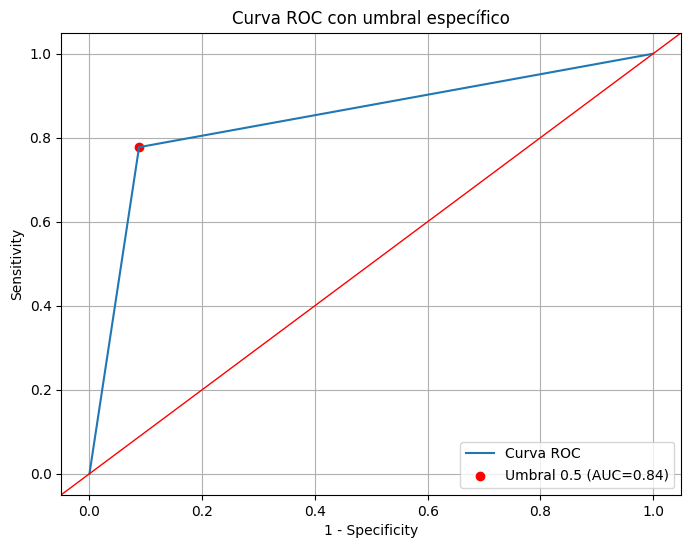

In [99]:
CalcularCurvaRoc(y_val_true, y_val_pred)

###Visualizar el modelo

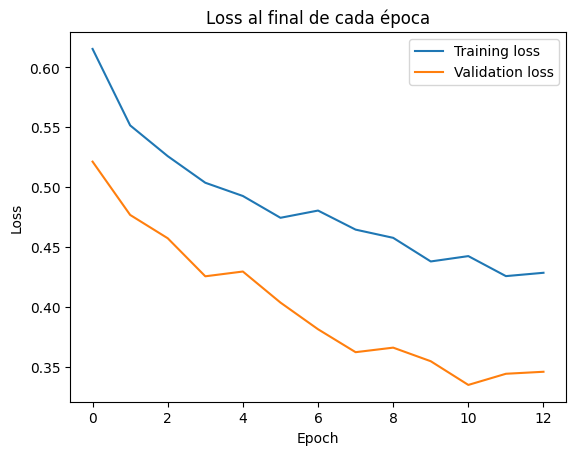

In [94]:
plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.title('Loss al final de cada época')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

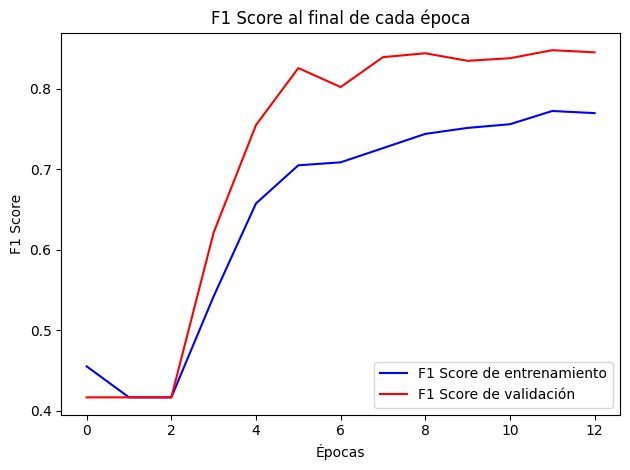

In [102]:

epochs = list(range(len(train_f1_scores)))

# Verifica que las listas tengan la misma longitud
assert len(epochs) == len(train_f1_scores) == len(val_f1_scores), "Las listas deben tener la misma longitud"

# Gráfica del F1 score
plt.plot(epochs, train_f1_scores, 'b-', label='F1 Score de entrenamiento')
plt.plot(epochs, val_f1_scores, 'r-', label='F1 Score de validación')
plt.title('F1 Score al final de cada época')
plt.xlabel('Épocas')
plt.ylabel('F1 Score')
plt.legend()
plt.tight_layout()
plt.show()


### Entrenar el modelo con learning rate scheduler

In [112]:
# Definición del optimizador y el scheduler
optimizer = optim.Adam(ModeloMejor.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

#el scheduler reducirá la tasa de aprendizaje cuando el F1-score deje de mejorar
scheduler = ReduceLROnPlateau(optimizer, 'max', factor=0.1, patience=10)



In [113]:
path_to_save_model = "./trabajo-deep-learning-ModeloMejor-lr.pth"
early_stopping = earlyStopping(patience=5, min_delta=0.01, mode="max")
model_checkpoint = modelCheckpoint(path=path_to_save_model, min_delta=0.01, mode="max")



In [114]:
import time
import torch
from sklearn.metrics import f1_score


# Inicialización de estructuras para almacenar métricas de rendimiento
train_losses = []
val_losses = []
train_correct = []
val_correct = []
train_f1_scores = []
val_f1_scores = []

epochs = 200   # Inicializar las épocas
val_loader = test_loader_desbalanceado

start_time = time.time()  # Comienza a medir el tiempo de entrenamiento

for epoch in range(epochs):
    ModeloMejor.train()  # Poner el modelo en modo entrenamiento
    trn_loss_epoch = 0
    trn_corr = 0
    total_train_samples = 0
    train_preds = []
    train_true = []

    for b, (X_train, y_train) in enumerate(train_loader_desbalanceado):
        X_train, y_train = X_train.to(device), y_train.to(device)  # Mover los datos al device definido
        optimizer.zero_grad()  # Limpiar los gradientes del optimizador
        y_pred = ModeloMejor(X_train)  # Obtener las predicciones del modelo
        loss = criterion(y_pred, y_train)  # Calcular la pérdida
        loss.backward()  # Realizar backpropagation
        optimizer.step()  # Actualizar los pesos del modelo

        trn_corr += (y_pred.argmax(1) == y_train).sum().item()
        total_train_samples += y_train.size(0)
        trn_loss_epoch += loss.item()
        train_preds.extend(y_pred.argmax(1).detach().cpu().numpy())
        train_true.extend(y_train.detach().cpu().numpy())

    train_f1 = f1_score(train_true, train_preds, average='macro')
    train_losses.append(trn_loss_epoch / len(train_loader_desbalanceado))
    train_correct.append(trn_corr)
    train_f1_scores.append(train_f1)

    ModeloMejor.eval()  # Poner el modelo en modo evaluación para la fase de validación
    val_loss_epoch = 0
    val_corr = 0
    val_preds = []
    val_true = []

    with torch.no_grad():  # Desactivar el cálculo de gradientes para la validación
        for X_val, y_val in val_loader:
            X_val, y_val = X_val.to(device), y_val.to(device)
            y_val_pred = ModeloMejor(X_val)
            val_loss_epoch += criterion(y_val_pred, y_val).item()
            val_corr += (y_val_pred.argmax(1) == y_val).sum().item()
            val_preds.extend(y_val_pred.argmax(1).detach().cpu().numpy())
            val_true.extend(y_val.detach().cpu().numpy())

    val_f1 = f1_score(val_true, val_preds, average='macro')
    val_losses.append(val_loss_epoch / len(val_loader))
    val_correct.append(val_corr)
    val_f1_scores.append(val_f1)


    scheduler.step(val_f1)

    # Llamar a earlyStopping y modelCheckpoint con el F1 score de validación
    early_stopping(val_f1)
    model_checkpoint(ModeloMejor, optimizer, val_f1)

    print(f'Epoch {epoch + 1}/{epochs}, Train Loss: {train_losses[-1]:.4f}, Train Acc: {trn_corr/total_train_samples:.4f}, '
          f'Train F1: {train_f1:.4f}, Val Loss: {val_losses[-1]:.4f}, Val Acc: {val_corr/len(val_loader.dataset):.4f}, '
          f'Val F1: {val_f1:.4f}')

    if early_stopping.stop:
        print("Deteniendo el entrenamiento por Early Stopping.")
        break

print(f'Duración: {time.time() - start_time:.0f} segundos')


Epoch 1/200, Train Loss: 0.3762, Train Acc: 0.8467, Train F1: 0.8126, Val Loss: 0.3050, Val Acc: 0.9014, Val F1: 0.8780
Epoch 2/200, Train Loss: 0.3774, Train Acc: 0.8403, Train F1: 0.8050, Val Loss: 0.2752, Val Acc: 0.9079, Val F1: 0.8849
Epoch 3/200, Train Loss: 0.3799, Train Acc: 0.8404, Train F1: 0.8061, Val Loss: 0.2738, Val Acc: 0.8971, Val F1: 0.8765
Epoch 4/200, Train Loss: 0.3634, Train Acc: 0.8496, Train F1: 0.8165, Val Loss: 0.2939, Val Acc: 0.8986, Val F1: 0.8746
Epoch 5/200, Train Loss: 0.3628, Train Acc: 0.8499, Train F1: 0.8166, Val Loss: 0.2711, Val Acc: 0.8893, Val F1: 0.8707
Epoch 6/200, Train Loss: 0.3717, Train Acc: 0.8407, Train F1: 0.8075, Val Loss: 0.2600, Val Acc: 0.9079, Val F1: 0.8885
Epoch 7/200, Train Loss: 0.3627, Train Acc: 0.8453, Train F1: 0.8128, Val Loss: 0.2930, Val Acc: 0.9050, Val F1: 0.8796
Epoch 8/200, Train Loss: 0.3611, Train Acc: 0.8506, Train F1: 0.8182, Val Loss: 0.2767, Val Acc: 0.9064, Val F1: 0.8824
Epoch 9/200, Train Loss: 0.3602, Train A

In [115]:

torch.save(ModeloMejor.state_dict(), path_to_save_model)

In [120]:
# Calcular el área bajo la curva ROC
auc_score = roc_auc_score(y_val_true, y_val_pred)

print("Área bajo la curva ROC (AUC):", auc_score)
fpr, tpr, thresholds = roc_curve(y_val_true, y_val_pred)



  # Definir un umbral específico
umbral = 0.5

  # Encontrar el índice del umbral más cercano en la lista de umbrales
indice_umbral = min(range(len(thresholds)), key=lambda i: abs(thresholds[i]-umbral))

  # Graficar la curva ROC con el umbral específico
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='Curva ROC')
plt.scatter(fpr[indice_umbral], tpr[indice_umbral], c='red', label=f'Umbral {umbral} (AUC={auc_score:.2f})')
plt.ylabel('Sensitivity')
plt.xlabel('1 - Specificity')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.title('Curva ROC con umbral específico')
plt.legend(loc=4)
plt.grid(True)
plt.show()

ValueError: Found input variables with inconsistent numbers of samples: [1400, 56]

In [116]:
CalcularCurvaRoc(y_val_true, y_val_pred)

ValueError: Found input variables with inconsistent numbers of samples: [1400, 56]

### Visualizar el modelo



In [ ]:

epochs = range(1, len(train_losses) + 1)  #es una lista que contiene los valores de pérdida al final de cada época de entrenamiento.
# Gráfica de la pérdida.
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_losses, 'b-', label='Loss Train')
plt.plot(epochs, val_losses, 'r-', label='Loss en validación')
plt.title('Loss al final de cada época')
plt.xlabel('Épocas')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [ ]:
 #Calculo de la precisión a partir del número de correctos
train_accuracy = [correct / len(train_loader_desbalanceado.dataset) * 100 for correct in train_correct]
val_accuracy = [correct / len(val_loader.dataset) * 100 for correct in val_correct]

# Gráfica de la precisión
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_accuracy, 'b-', label='Precisión de entrenamiento')
plt.plot(epochs, val_accuracy, 'r-', label='Precisión de validación')
plt.title('Precisión al final de cada época')
plt.xlabel('Épocas')
plt.ylabel('Precisión (%)')
plt.legend()

plt.tight_layout()  # Ajusta automáticamente los subplots para que encajen en la figura
plt.show()#

In [ ]:
print(val_correct) # los resultados de todas las épocas


# Asumiendo que 'len(val_loader.dataset)' es la cantidad de muestras en el conjunto de validación
print(f'Test accuracy: {val_correct[-1]*100/len(test_loader_desbalanceado.dataset):.3f}%')  # Imprime el resultado más reciente como porcentaje

# **Conditional GAN con Pytorch**

Vamos a crear imágenes sintéticas de la clase camiones

**1- Entrenamiento de la GAN con el Conjunto Completo**

**2- Generación de Imágenes de la Clase Minoritaria (clase =truck)**

## Generador

Tamaño de salida de cada capa:
(W - 1) * stride - 2 * padding + kernel_size

1. **make_gen_block(z_dim, hidden_dim * 8, kernel_size=4, stride=1, padding=0)**
   - Tamaño de entrada: `(batch_size, z_dim, 1, 1)` —
   - Tamaño de salida: (W - 1) * stride - 2 * padding + kernel_size = (1 - 1) * 1 - 2 * 0 + 4 = 4. Tanto para H
out como para Hin
    - La salida es (batch_size, hidden_dim * 8, 4, 4)`.

2. **Segunda capa (`make_gen_block(hidden_dim * 8, hidden_dim * 4, kernel_size=4, stride=2, padding=1)`):**
   - Tamaño de entrada: `(batch_size, hidden_dim * 8, 4, 4)`.
   - Tamaño de salida:  `(W - 1) * stride - 2 * padding + kernel_size = (4 - 1) * 2 - 2 * 1 + 4 = 8`,
   - La salida es  `(batch_size, hidden_dim * 4, 8, 8)`.

3. **Tercera capa (`make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=2, padding=1)`):**
   - Tamaño de entrada: `(batch_size, hidden_dim * 4, 8, 8)`.
   - Tamaño de salida: (W - 1) * stride - 2 * padding + kernel_size = (8 - 1) * 2 - 2 * 1 + 4 = 16,
   - La salida es  `(batch_size, hidden_dim * 2, 16, 16)`.


4. **Cuarta capa (`make_gen_block(hidden_dim * 2, hidden_dim, kernel_size=4, stride=2, padding=1)`):**
   - Tamaño de entrada: `(batch_size, hidden_dim * 2, 16, 16)
   - Tamaño de salida: (W - 1) * stride - 2 * padding + kernel_size = (16 - 1) * 2 - 2 * 1 + 4 = 32
   - La salida es (batch_size, hidden_dim, 32, 32)`.

5. **Quinta capa (última capa, `make_gen_block(hidden_dim, im_chan, kernel_size=4, stride=2, padding=1, final_layer=True)`):**
   - Tamaño de entrada: `(batch_size, hidden_dim, 32, 32)`.
   - Tamaño de salida: Ajustar el número de canales al número deseado para la imagen de salida, manteniendo el tamaño espacial. Por tanto, el tamaño de salida es `(batch_size, im_chan=3, 32, 32)`.



In [122]:
class Generator(nn.Module):
    def __init__(self, input_dim, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Capas del generador, usando bloques generadores
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 8, kernel_size=4, stride=1, padding=0),
            # Tamaño después de esta capa: [batch_size, hidden_dim*8, 4, 4]
            self.make_gen_block(hidden_dim * 8, hidden_dim * 4, kernel_size=4, stride=2, padding=1),
            # Tamaño después de esta capa: [batch_size, hidden_dim*4, 8, 8]
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            # Tamaño después de esta capa: [batch_size, hidden_dim*2, 16, 16]
            self.make_gen_block(hidden_dim * 2, im_chan, kernel_size=4, stride=2, padding=1, final_layer=True),

        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, padding=1, final_layer=False):
        # Bloque generador que incluye una convolución transpuesta, batchnorm (excepto en la capa final) y ReLU (excepto en la capa final donde se usa Tanh)
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding, bias=False),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else: # En la capa final, se utiliza Tanh sin BatchNorm
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding, bias=False),
                nn.Tanh(),
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)


In [123]:
def get_noise(n_samples, input_dim, device='cpu'):
  #un tensor que tiene la forma (n_samples, input_dim), donde cada elemento
  #es un número aleatorio generado de una distribución normal estándar (media 0, desviación estándar 1).
  return torch.randn(n_samples, input_dim, device=device)


## Discriminador

In [124]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=3, hidden_dim=64):
      super(Discriminator, self).__init__()
      self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )


    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor,
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)


In [125]:
def get_one_hot_labels(labels, n_classes):
    '''
    #torch.nn.functional.one_hot(tensor, num_classes=-1) → LongTensor
    Función get_one_hot_labels: Esta función toma dos argumentos:

      labels: Un tensor de las etiquetas de las imágenes. Por ejemplo, en un lote de datos del CIFAR-10, labels podría ser un tensor de tamaño (batch_size,),
      # donde cada elemento es un entero que representa la clase de una imagen en el lote.
      n_classes: El número total de clases en el conjunto de datos. Para CIFAR-10, este valor es 10.
      La función utiliza F.one_hot para convertir las etiquetas en vectores one-hot.
      F.one_hot(labels, num_classes=n_classes) transforma cada etiqueta en el tensor labels en un vector one-hot de longitud n_classes. Cada vector tiene un 1 en el índice correspondiente a la clase de la etiqueta y 0 en todos los demás índices.
      El vector es todo 0 y un 1 en la clase elegida: One Hot Encoding (OHE)
      El uso de la codificación one-hot permite que el modelo distinga claramente entre las diferentes clases al generar imágenes, haciendo posible la generación dirigida por clases.
    '''
    return F.one_hot(labels, num_classes=n_classes)


In [126]:
def combine_vectors(x, y):
    '''
      Esta función concatena los tensores x y y a lo largo de la dimensión 1.
         x es un tensor de ruido con forma [n_samples, z_dim]
        y es un tensor de etiquetas one-hot con forma [n_samples, n_classes]
        el resultado será un tensor con forma [n_samples, z_dim + n_classes]
    '''
    combined = torch.cat((x, y), dim=1).float()

    return combined

In [127]:
def show_tensor_images(image_tensor, num_images=25, size=(3, 32, 32), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

## Entrenamiento

* cifar_shape: el número de píxeles de cada imagen CIFAR, que tiene unas dimensiones de 32 x 32 y TRES canales (porque es a color), así que 3 x 32 x 32
* n_classes: el número de clases en CIFAR10 =10,

In [137]:
cifar10_shape = (3, 32, 32)
n_classes = 2

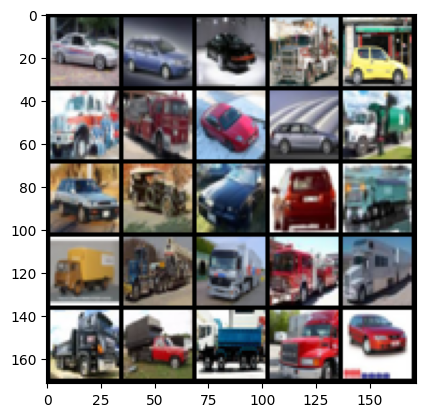

In [138]:
criterion = nn.BCEWithLogitsLoss()

# Ajustes en el número de épocas y la dimensión del espacio latente.
n_epochs = 100
z_dim = 100  # Aumento en la dimensión del espacio latente para mayor diversidad en la generación.

# Ajuste en el paso de visualización para ver resultados con más frecuencia.
display_step = 500

# Tamaño del lote y tasa de aprendizaje ajustados.
batch_size = 64  # no lo pongo grande para no tener problemas de memoria
lr = 0.0001  # Ajuste fino en la tasa de aprendizaje.

device = 'cuda' if torch.cuda.is_available() else 'cpu'


transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Normalización
])

# DataLoader para CIFAR-10.

# Crear los subconjuntos de entrenamiento y prueba con transformaciones
subset_train = CIFAR10Subset(full_train_data, class_indices, class_names, transform)

dataloader = DataLoader(subset_train, batch_size=64, shuffle=True)


# Función para visualizar imágenes.
def show_images(image_tensor, num_images=25, size=(3, 32, 32)):
    image_shifted = (image_tensor + 1) / 2
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

# Ejemplo de visualización de un lote de imágenes.
for X, y in dataloader:
    show_images(X, num_images=25, size=(3, 32, 32))
    break


In [139]:
def get_input_dimensions(z_dim, cifar10_shape, n_classes):
    '''
    z_dim + n_classes: Calcula la dimensión de entrada para el generador sumando la dimensión del espacio latente (z_dim) y el número de clases (n_classes).
    discriminator_im_chan = mnist_shape[0] + n_classes: Calcula el número de canales de entrada para el discriminador sumando el número de canales de la imagen
     (cifar10_shape[0], que sería 3 para imágenes en color de CIFA10) y el número de clases.

    Returns:
        generator_input_dim: the input dimensionality of the conditional generator,
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 32 x 32 for CIFAR10)
    '''

    generator_input_dim = z_dim +  n_classes  # vector de ruido = 100 , n_classes=10 (matrices de cero , excepto la que toca que es de unos )
    discriminator_im_chan = cifar10_shape[0] +  n_classes  #ahora va a tener 13 canales de entrada
    return generator_input_dim, discriminator_im_chan

In [140]:
n_classes

2

In [141]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, cifar10_shape, n_classes)



In [142]:
gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
  #Inicializar los pesos
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

In [143]:
discriminator_im_chan

5

In [144]:
generator_input_dim

102

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 500: Generator loss: 0.8731957650184632, discriminator loss: 0.5762328421473503


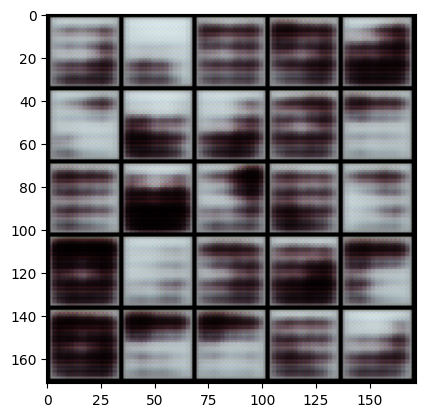

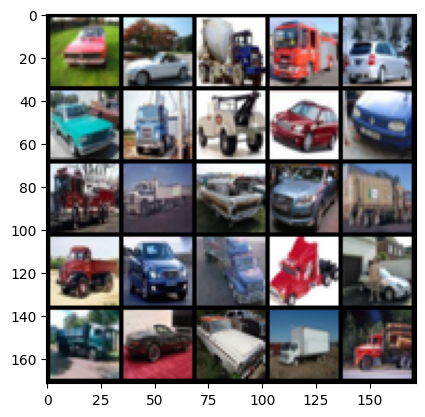

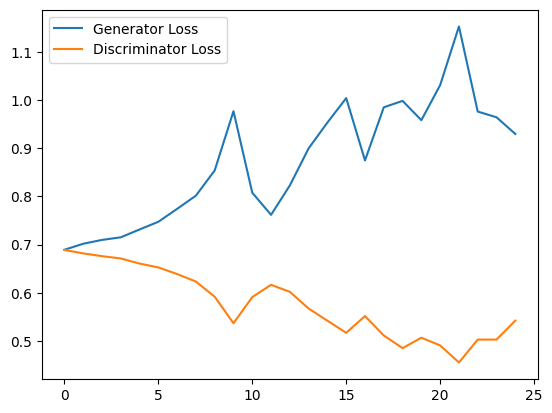

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

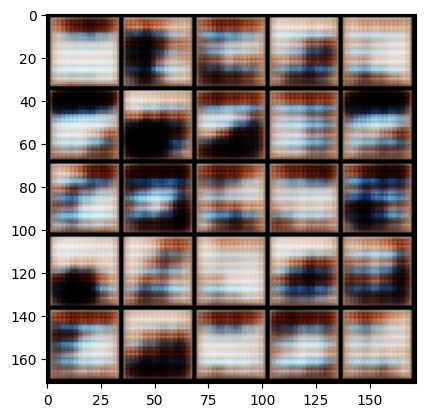

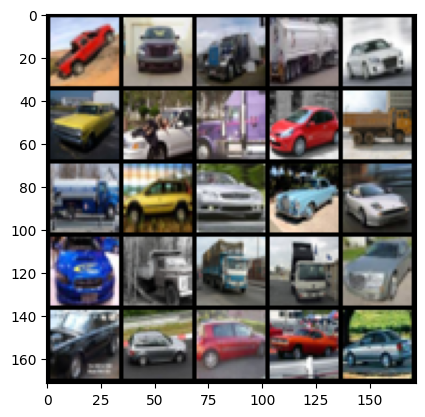

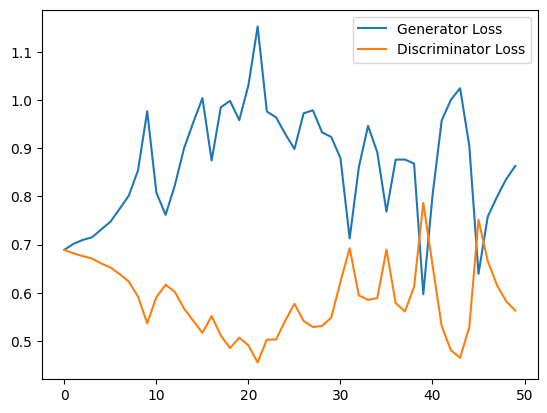

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

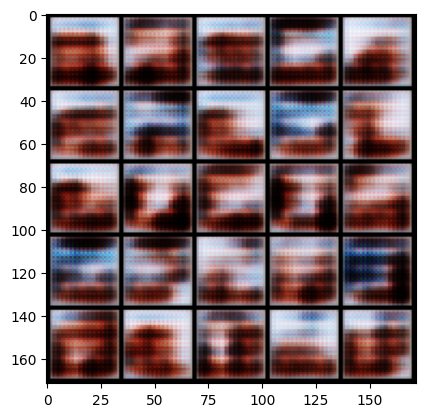

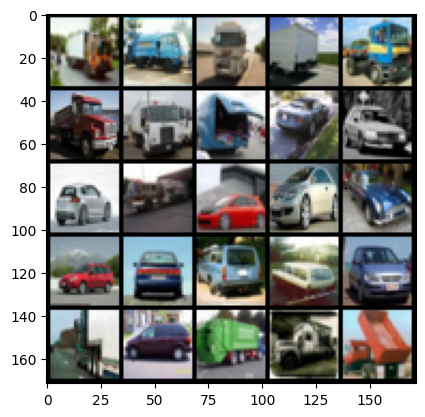

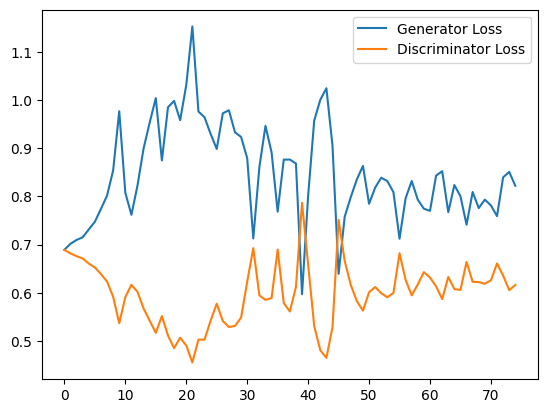

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

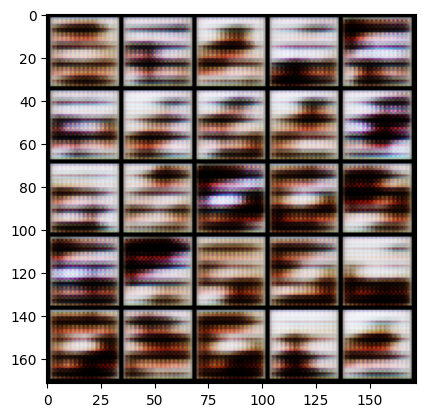

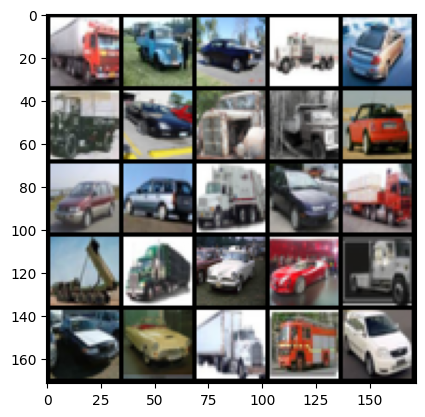

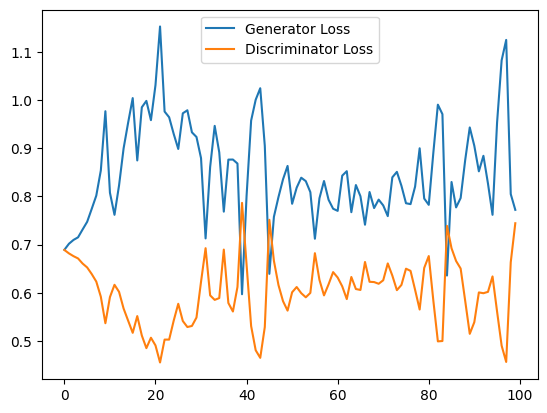

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([16, 100])


  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

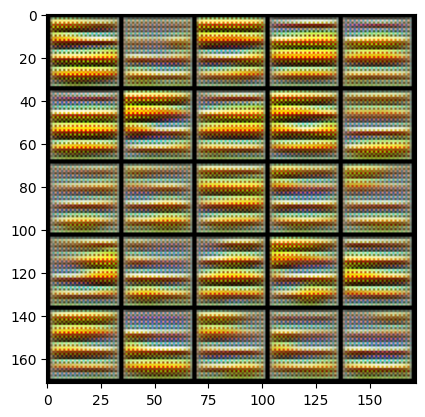

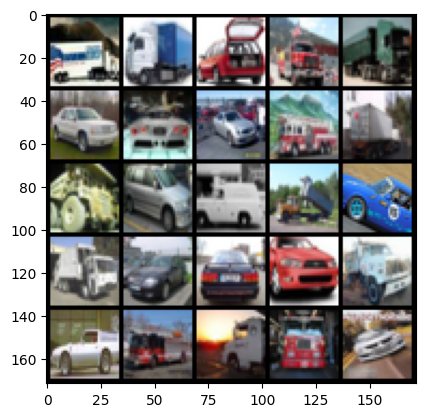

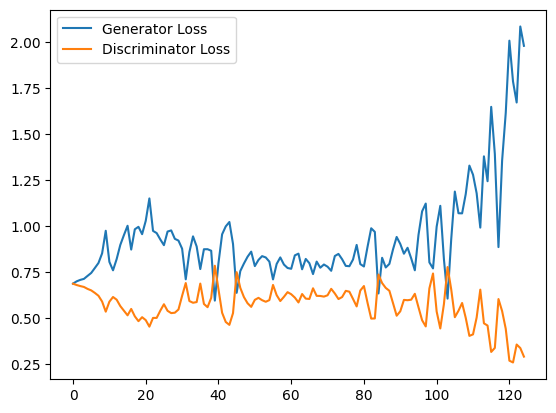

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([16, 100])


  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 3000: Generator loss: 1.8209071102142333, discriminator loss: 0.3049519558250904


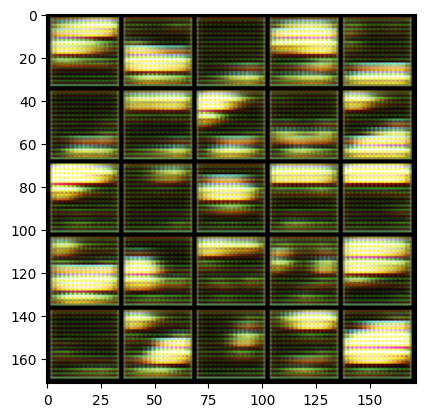

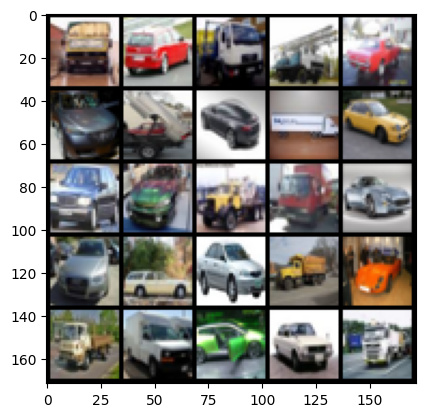

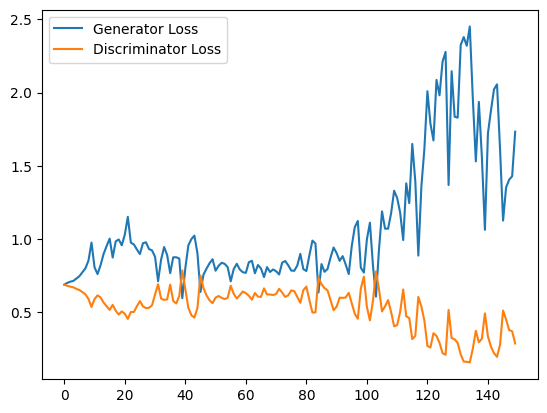

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

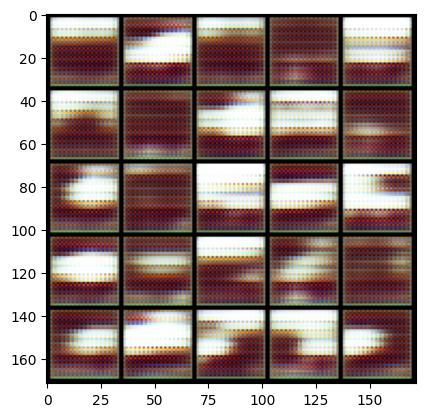

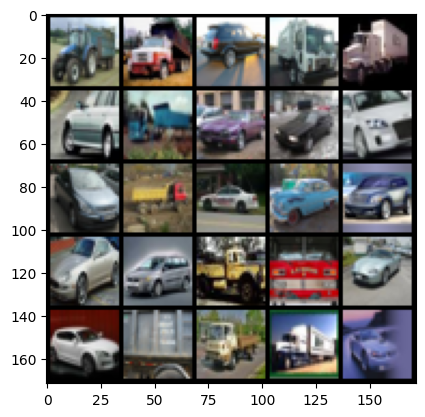

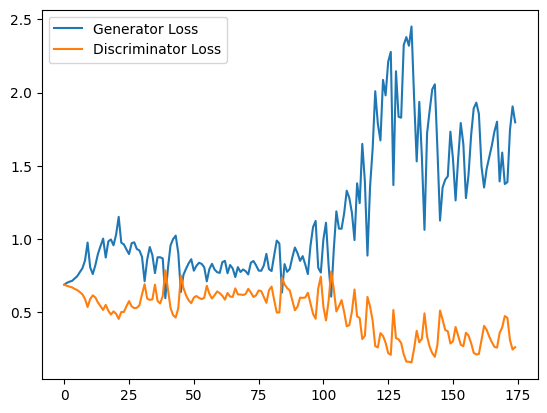

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

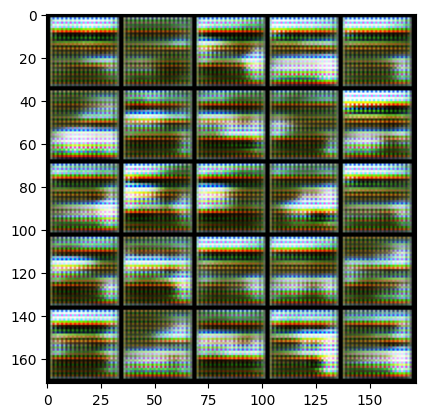

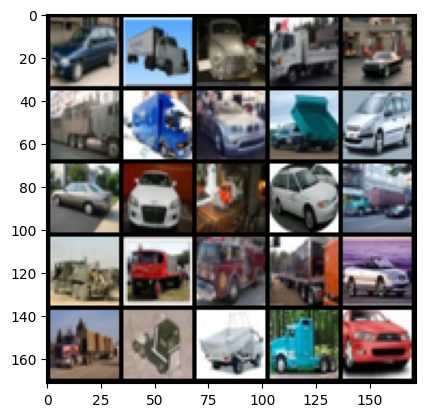

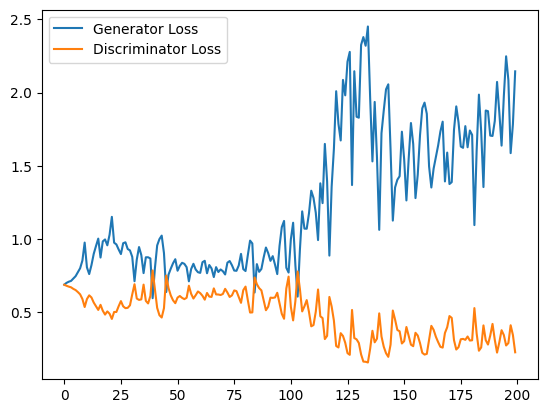

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

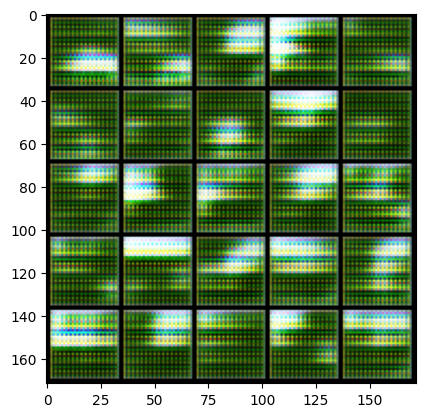

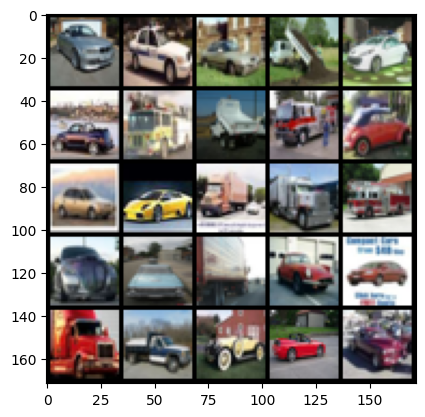

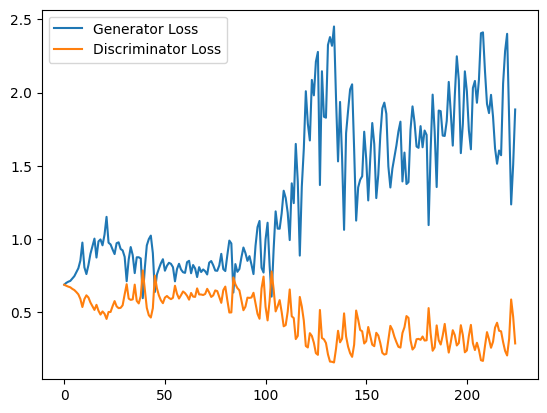

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

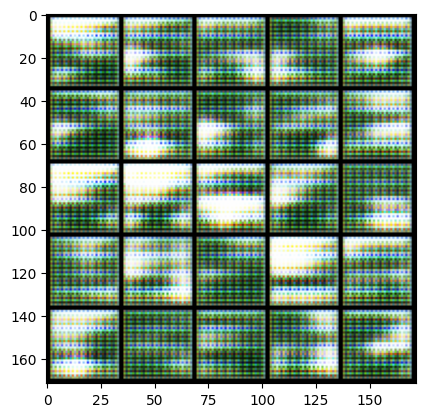

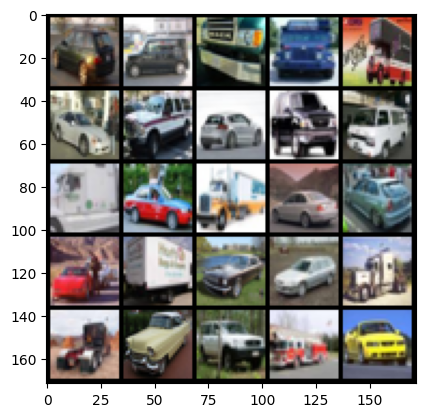

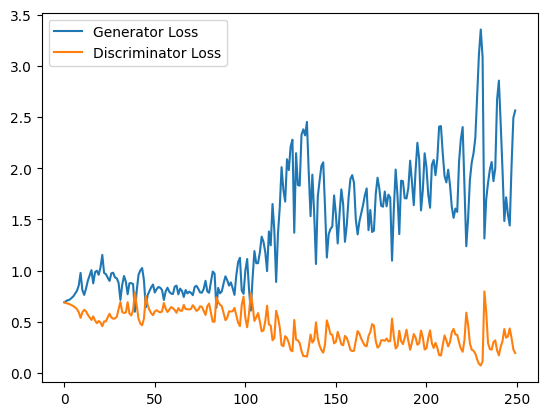

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([16, 100])


  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 5500: Generator loss: 2.0253735085725784, discriminator loss: 0.28228386434912683


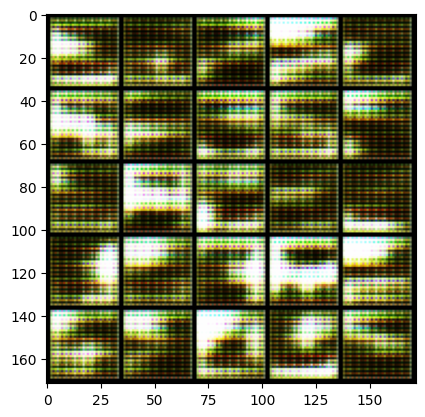

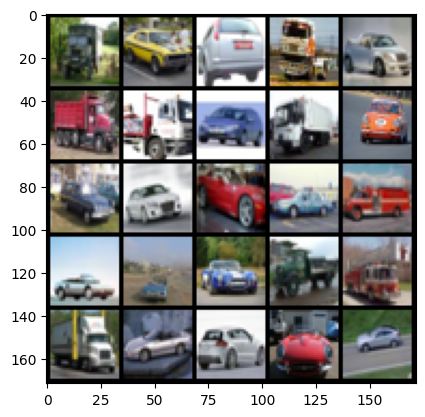

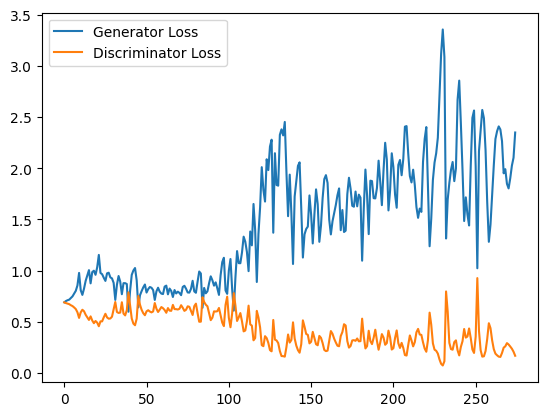

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 6000: Generator loss: 1.9952179324626922, discriminator loss: 0.2614807795882225


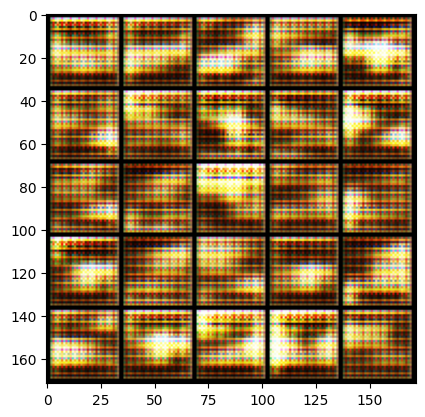

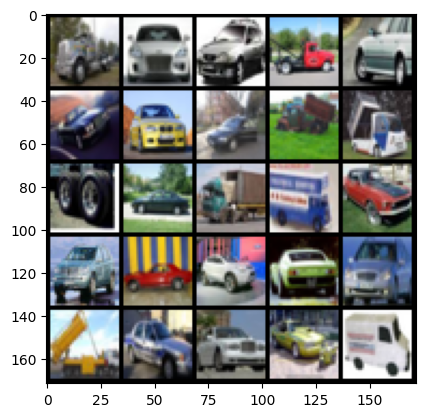

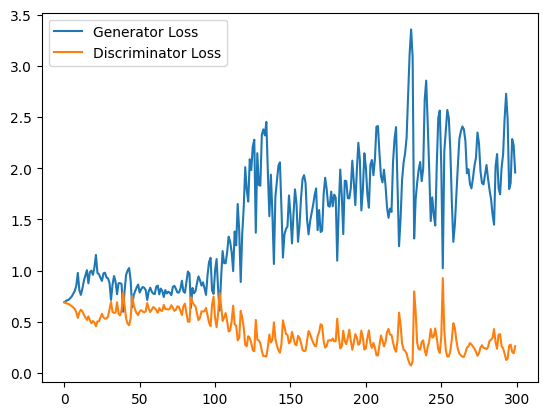

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

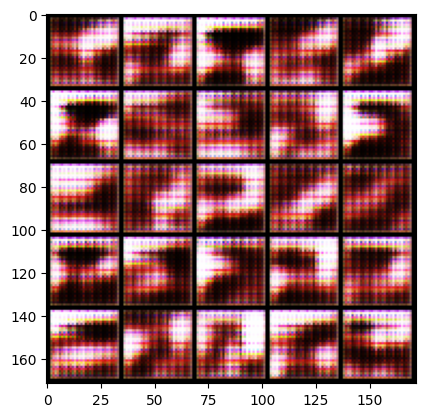

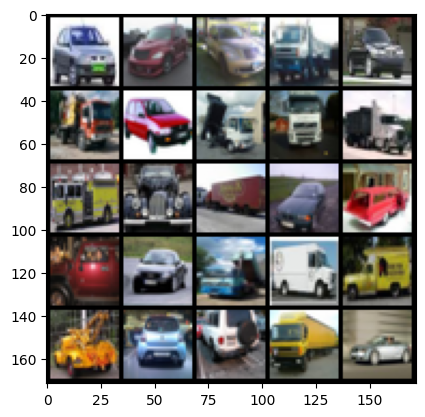

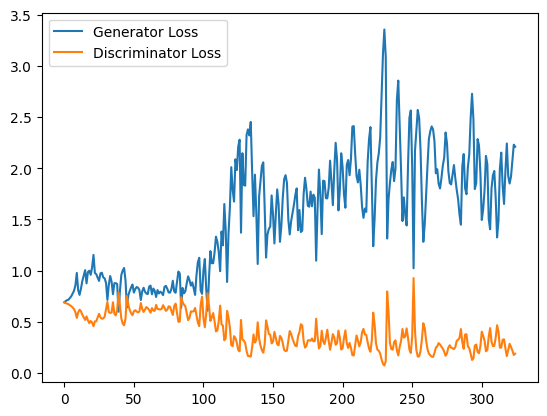

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

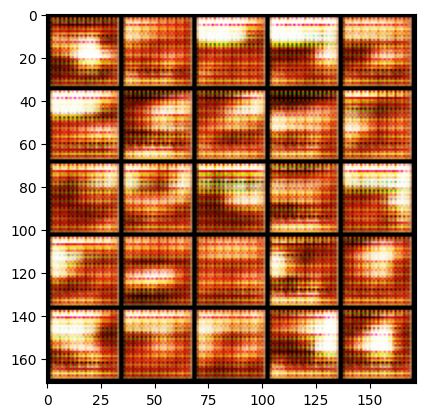

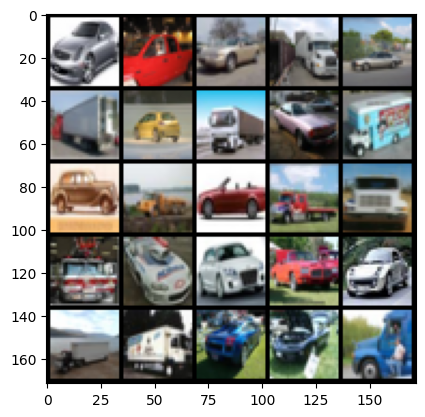

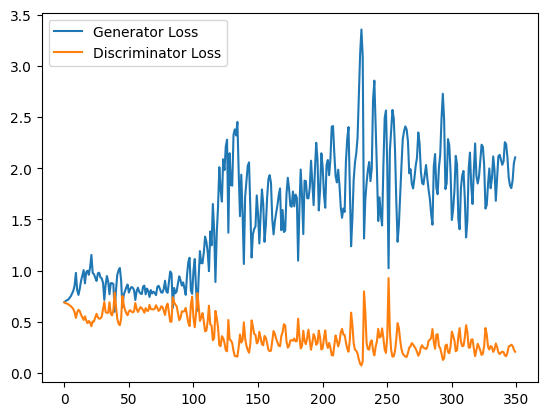

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

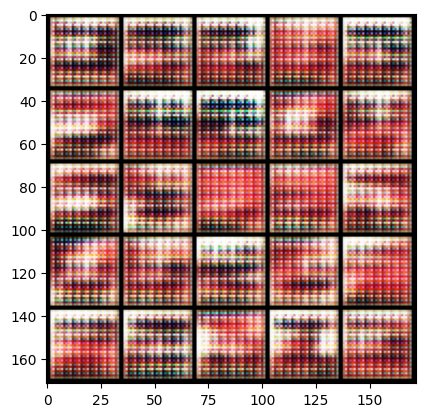

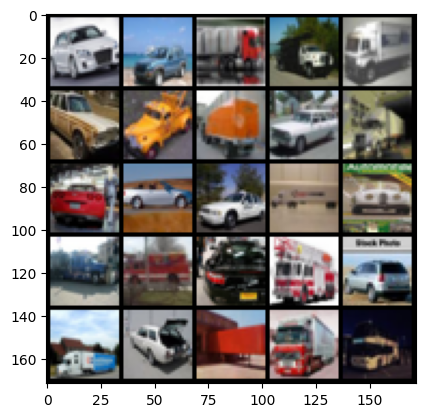

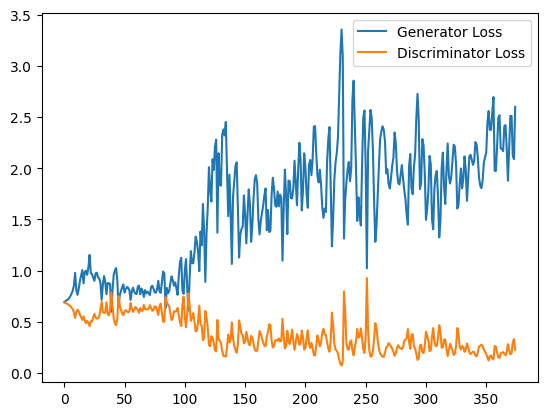

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([16, 100])


  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

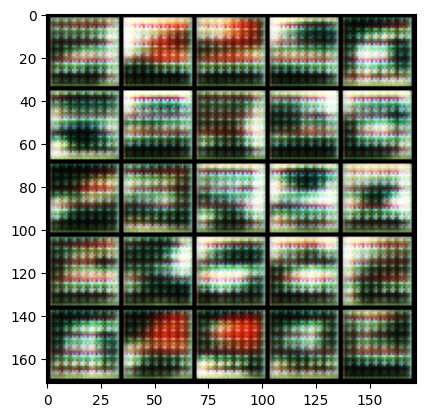

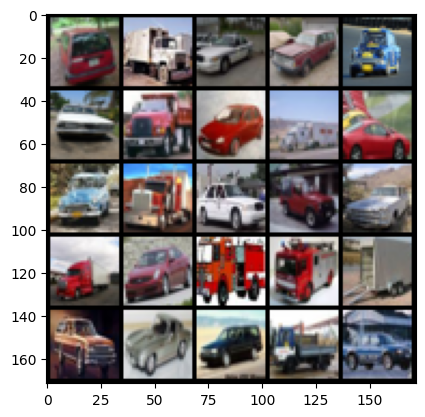

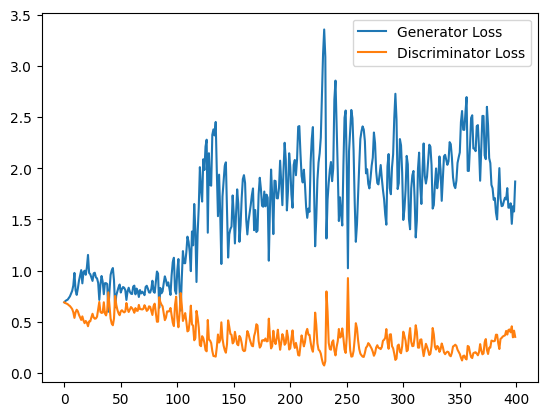

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([16, 100])


  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 8500: Generator loss: 1.587226342201233, discriminator loss: 0.393845142275095


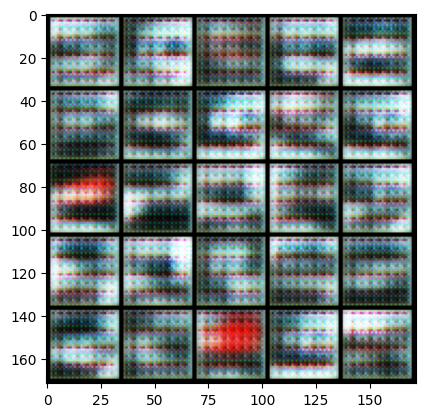

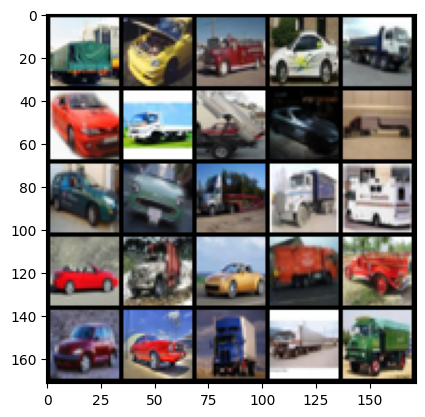

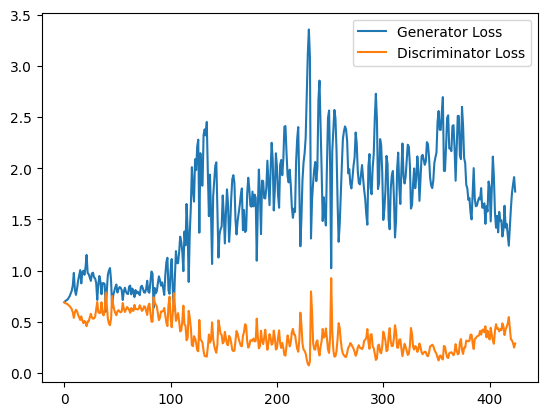

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

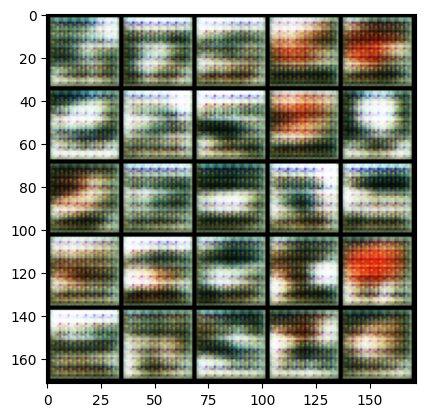

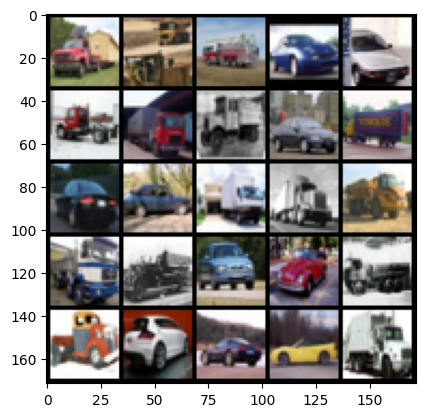

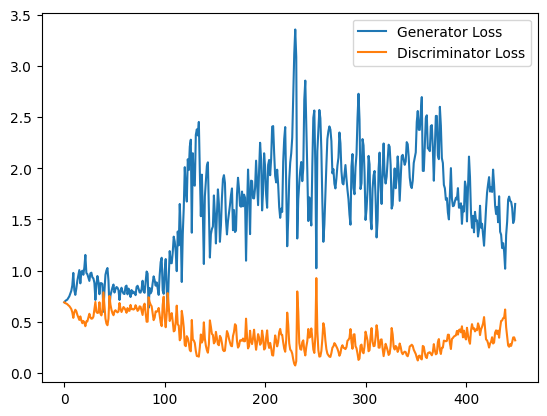

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

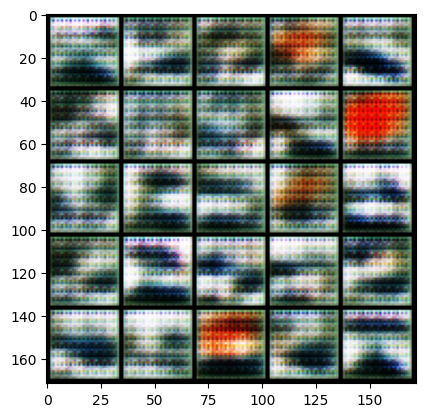

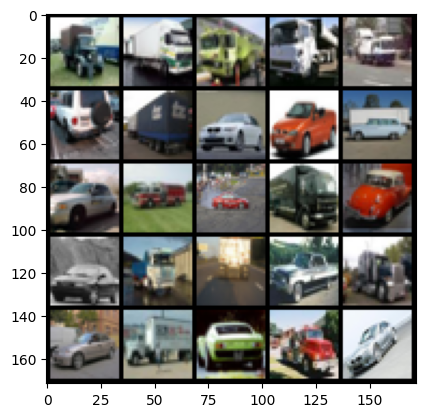

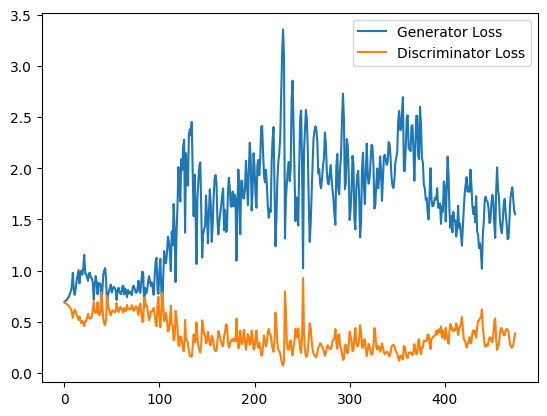

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

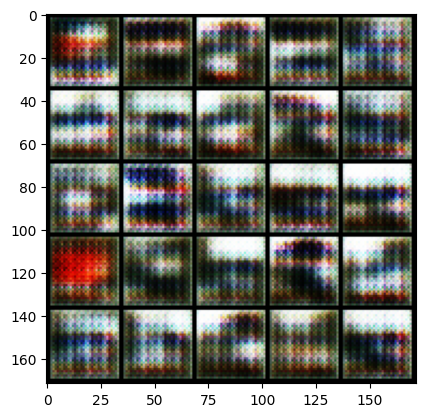

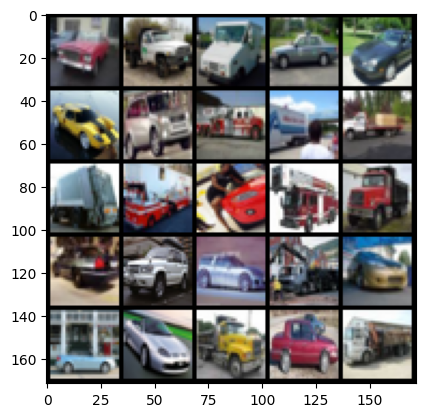

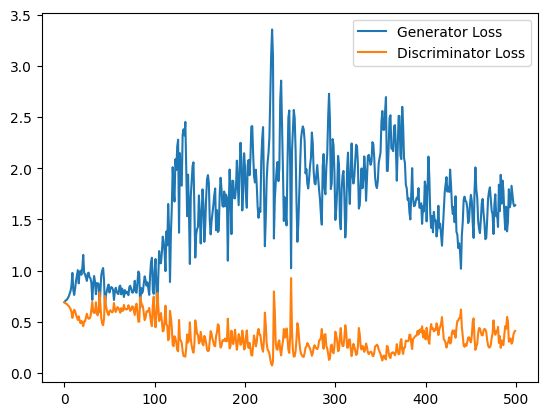

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

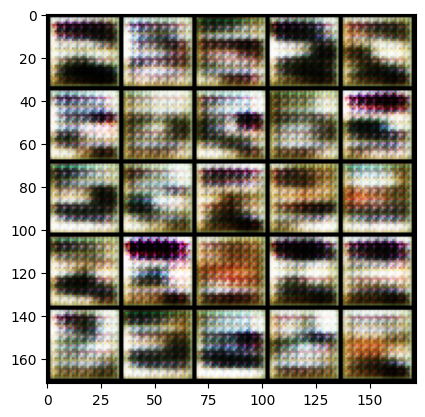

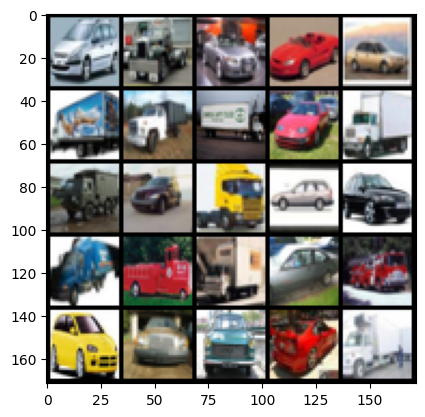

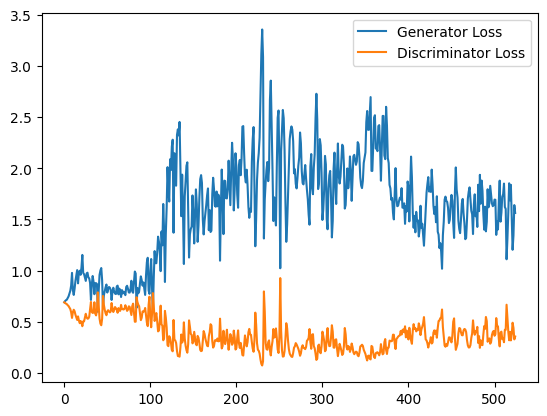

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([16, 100])


  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 11000: Generator loss: 1.507597985625267, discriminator loss: 0.42285126143693924


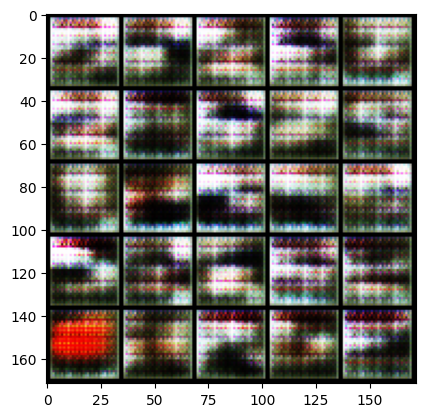

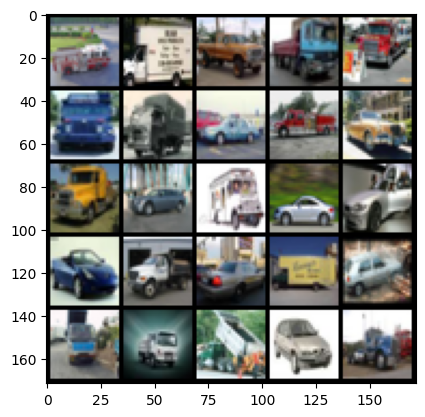

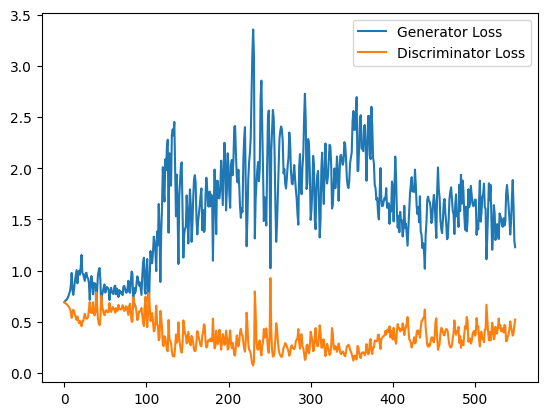

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
Step 11500: Generator loss: 1.3362350599765778, discriminator loss: 0.5166745308041573


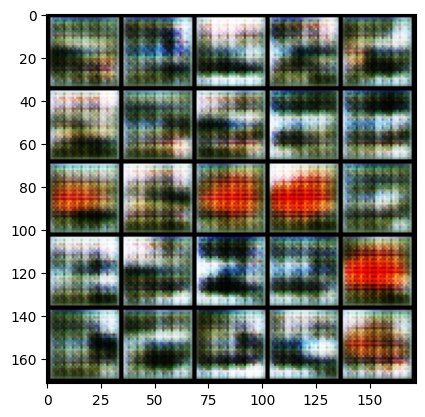

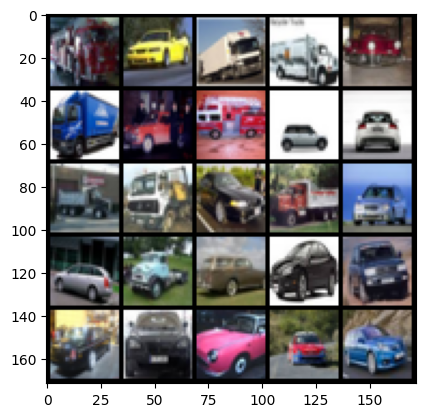

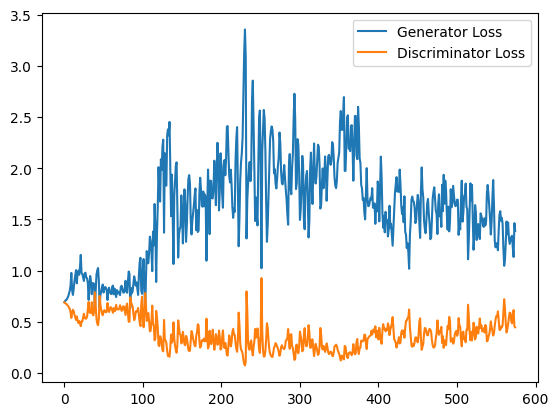

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

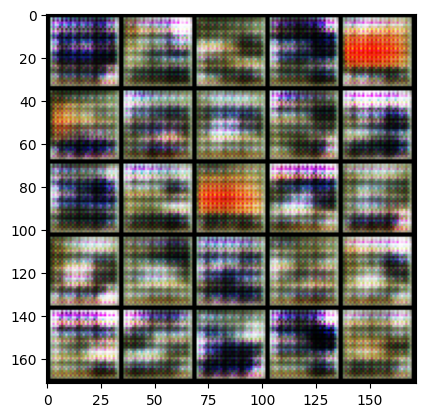

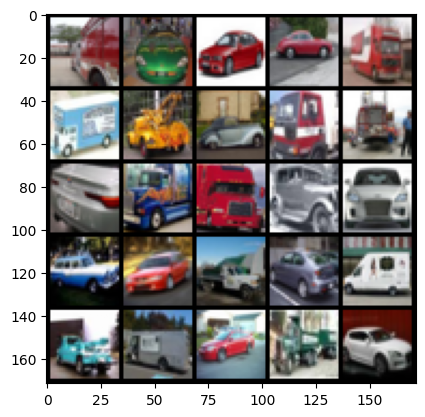

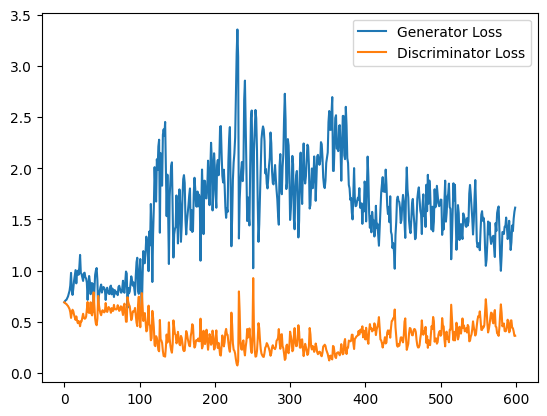

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size

  0%|          | 0/157 [00:00<?, ?it/s]

torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])
torch.Size([64, 100])


In [ ]:
from tqdm.auto import tqdm
cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1,cifar10_shape[1], cifar10_shape[2])  # Ajuste para tamaño de imagen CIFAR-10

        expanded_labels = one_hot_labels.repeat(1, 3, 1, 1)  # Ahora tiene forma [batch_size, 3, 32, 32]

        ### Actualización del discriminador ###
        disc_opt.zero_grad()

        fake_noise = get_noise(cur_batch_size, z_dim, device=device)

        print(fake_noise.shape)
        one_hot_labels

        # Combinar ruido y etiquetas para el generador
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)

        fake = gen(noise_and_labels)


        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 3, cifar10_shape[1], cifar10_shape[2])


        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        #fake_image_and_labels = combine_vectors(fake, expanded_labels)

        real_image_and_labels = combine_vectors(real, image_one_hot_labels)

        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward()
        disc_opt.step()

        discriminator_losses.append(disc_loss.item())

        ### Actualización del generador ###
        gen_opt.zero_grad()
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        generator_losses.append(gen_loss.item())

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1


## **Salvar los modelos**

In [2]:
# First time (at least) we can(must) save the models trained
torch.save(gen.state_dict(), 'Conditional_GAN_CIFAR10_Gen.pt')
torch.save(disc.state_dict(), 'Conditional_GAN_CIFAR10_Disc.pt')

NameError: name 'torch' is not defined

##Cargar y probar modelos salvados

In [ ]:
# Creating exactly the same model, and to device
gen2 = Generator(input_dim=generator_input_dim).to(device)
gen2.load_state_dict(torch.load('Conditional_GAN_CIFAR10_Gen.pt'))

# Only Generator is necessary to see new samples, but loading discriminator too
disc2 = Discriminator(im_chan=discriminator_im_chan).to(device)
disc2.load_state_dict(torch.load('Conditional_GAN_CIFAR10_Disc.pt'))

In [ ]:
disc2.train()
gen2.train()

In [ ]:
cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, 32, 32)  # Ajuste para tamaño de imagen CIFAR-10

        ### Actualización del discriminador ###
        disc_opt.zero_grad()

        fake_noise = get_noise(cur_batch_size, z_dim, device=device)

        # Combinar ruido y etiquetas para el generador
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)

        fake = gen2(noise_and_labels)


        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 3, cifar10_shape[1], cifar10_shape[2])


        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)

        disc_fake_pred = disc2(fake_image_and_labels.detach())
        disc_real_pred = disc2(real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward()
        disc_opt.step()

        discriminator_losses.append(disc_loss.item())

        ### Actualización del generador ###
        gen_opt.zero_grad()
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        disc_fake_pred = disc2(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        generator_losses.append(gen_loss.item())

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

In [ ]:
torch.save(gen2.state_dict(), 'Conditional_GAN_CIFAR10_Gen2.pt')
torch.save(disc2.state_dict(), 'Conditional_GAN_CIFAR10_Disc2.pt')

##Generar ruido


In [ ]:
import math
def interpolate_class_cifar(first_class, second_class, n_interpolation=15):
    # Generar el ruido base que será el mismo para todas las imágenes generadas
    interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

    # Crear las etiquetas one-hot para las dos clases que quieres interpolar
    first_label = get_one_hot_labels(torch.Tensor([first_class]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_class]).long(), n_classes)

    # Generar el vector de interpolación entre las dos etiquetas
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]

    # Interpolar entre las etiquetas one-hot de las dos clases
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combinar el ruido con las etiquetas interpoladas
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))

    # Generar las imágenes interpoladas
    interpolated_images = gen(noise_and_labels)

    # Mostrar las imágenes interpoladas
    show_tensor_images(interpolated_images, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=True)

# interpolar entre las clases "automóvil" y "camión"
start_class = 1  #  'car'
end_class = 9    # 'truck'
interpolate_class_cifar(start_class, end_class)


In [ ]:
n_images = 10  # Número de imágenes que quieres generar
z_dim = 100  # Dimensión del espacio latente
noise = get_noise(n_images, z_dim, device=device)


Preparar las Etiquetas de la Clase "truck": Crea etiquetas one-hot para la clase "truck"

In [ ]:
labels = torch.zeros(n_images, 10).to(device)  #  número total de clases en CIFAR-10 = 10
labels[:, 9] = 1  # 9 es la etiqueta para "truck"



In [ ]:
input_gen = torch.cat((noise, labels), dim=1)


In [ ]:
gen.eval()  # modo de evaluación
fake_images = gen(input_gen)


In [ ]:
show_images(fake_images.data)  # Ajusta esta función según cómo implementaste la visualización
